In [1]:
import torch
from torch import nn
from torch.optim import Adam, Optimizer
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np
import torchvision
import torchvision.transforms as transforms
from torchsummary import summary

%matplotlib inline

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [33]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Autoaugment [code from this repo](https://github.com/DeepVoltaire/AutoAugment)

In [34]:
from PIL import Image, ImageEnhance, ImageOps
import random


class ShearX(object):
    def __init__(self, fillcolor=(128, 128, 128)):
        self.fillcolor = fillcolor

    def __call__(self, x, magnitude):
        return x.transform(
            x.size, Image.AFFINE, (1, magnitude * random.choice([-1, 1]), 0, 0, 1, 0),
            Image.BICUBIC, fillcolor=self.fillcolor)


class ShearY(object):
    def __init__(self, fillcolor=(128, 128, 128)):
        self.fillcolor = fillcolor

    def __call__(self, x, magnitude):
        return x.transform(
            x.size, Image.AFFINE, (1, 0, 0, magnitude * random.choice([-1, 1]), 1, 0),
            Image.BICUBIC, fillcolor=self.fillcolor)


class TranslateX(object):
    def __init__(self, fillcolor=(128, 128, 128)):
        self.fillcolor = fillcolor

    def __call__(self, x, magnitude):
        return x.transform(
            x.size, Image.AFFINE, (1, 0, magnitude * x.size[0] * random.choice([-1, 1]), 0, 1, 0),
            fillcolor=self.fillcolor)


class TranslateY(object):
    def __init__(self, fillcolor=(128, 128, 128)):
        self.fillcolor = fillcolor

    def __call__(self, x, magnitude):
        return x.transform(
            x.size, Image.AFFINE, (1, 0, 0, 0, 1, magnitude * x.size[1] * random.choice([-1, 1])),
            fillcolor=self.fillcolor)


class Rotate(object):
    # from https://stackoverflow.com/questions/
    # 5252170/specify-image-filling-color-when-rotating-in-python-with-pil-and-setting-expand
    def __call__(self, x, magnitude):
        rot = x.convert("RGBA").rotate(magnitude * random.choice([-1, 1]))
        return Image.composite(rot, Image.new("RGBA", rot.size, (128,) * 4), rot).convert(x.mode)


class Color(object):
    def __call__(self, x, magnitude):
        return ImageEnhance.Color(x).enhance(1 + magnitude * random.choice([-1, 1]))


class Posterize(object):
    def __call__(self, x, magnitude):
        return ImageOps.posterize(x, magnitude)


class Solarize(object):
    def __call__(self, x, magnitude):
        return ImageOps.solarize(x, magnitude)


class Contrast(object):
    def __call__(self, x, magnitude):
        return ImageEnhance.Contrast(x).enhance(1 + magnitude * random.choice([-1, 1]))


class Sharpness(object):
    def __call__(self, x, magnitude):
        return ImageEnhance.Sharpness(x).enhance(1 + magnitude * random.choice([-1, 1]))


class Brightness(object):
    def __call__(self, x, magnitude):
        return ImageEnhance.Brightness(x).enhance(1 + magnitude * random.choice([-1, 1]))


class AutoContrast(object):
    def __call__(self, x, magnitude):
        return ImageOps.autocontrast(x)


class Equalize(object):
    def __call__(self, x, magnitude):
        return ImageOps.equalize(x)


class Invert(object):
    def __call__(self, x, magnitude):
        return ImageOps.invert(x)

In [35]:
import numpy as np


class CIFAR10Policy(object):
    """ Randomly choose one of the best 25 Sub-policies on CIFAR10.

        Example:
        >>> policy = CIFAR10Policy()
        >>> transformed = policy(image)

        Example as a PyTorch Transform:
        >>> transform=transforms.Compose([
        >>>     transforms.Resize(256),
        >>>     CIFAR10Policy(),
        >>>     transforms.ToTensor()])
    """
    def __init__(self, fillcolor=(128, 128, 128)):
        self.policies = [
            SubPolicy(0.1, "invert", 7, 0.2, "contrast", 6, fillcolor),
            SubPolicy(0.7, "rotate", 2, 0.3, "translateX", 9, fillcolor),
            SubPolicy(0.8, "sharpness", 1, 0.9, "sharpness", 3, fillcolor),
            SubPolicy(0.5, "shearY", 8, 0.7, "translateY", 9, fillcolor),
            SubPolicy(0.5, "autocontrast", 8, 0.9, "equalize", 2, fillcolor),

            SubPolicy(0.2, "shearY", 7, 0.3, "posterize", 7, fillcolor),
            SubPolicy(0.4, "color", 3, 0.6, "brightness", 7, fillcolor),
            SubPolicy(0.3, "sharpness", 9, 0.7, "brightness", 9, fillcolor),
            SubPolicy(0.6, "equalize", 5, 0.5, "equalize", 1, fillcolor),
            SubPolicy(0.6, "contrast", 7, 0.6, "sharpness", 5, fillcolor),

            SubPolicy(0.7, "color", 7, 0.5, "translateX", 8, fillcolor),
            SubPolicy(0.3, "equalize", 7, 0.4, "autocontrast", 8, fillcolor),
            SubPolicy(0.4, "translateY", 3, 0.2, "sharpness", 6, fillcolor),
            SubPolicy(0.9, "brightness", 6, 0.2, "color", 8, fillcolor),
            SubPolicy(0.5, "solarize", 2, 0.0, "invert", 3, fillcolor),

            SubPolicy(0.2, "equalize", 0, 0.6, "autocontrast", 0, fillcolor),
            SubPolicy(0.2, "equalize", 8, 0.6, "equalize", 4, fillcolor),
            SubPolicy(0.9, "color", 9, 0.6, "equalize", 6, fillcolor),
            SubPolicy(0.8, "autocontrast", 4, 0.2, "solarize", 8, fillcolor),
            SubPolicy(0.1, "brightness", 3, 0.7, "color", 0, fillcolor),

            SubPolicy(0.4, "solarize", 5, 0.9, "autocontrast", 3, fillcolor),
            SubPolicy(0.9, "translateY", 9, 0.7, "translateY", 9, fillcolor),
            SubPolicy(0.9, "autocontrast", 2, 0.8, "solarize", 3, fillcolor),
            SubPolicy(0.8, "equalize", 8, 0.1, "invert", 3, fillcolor),
            SubPolicy(0.7, "translateY", 9, 0.9, "autocontrast", 1, fillcolor)
        ]

    def __call__(self, img):
        policy_idx = random.randint(0, len(self.policies) - 1)
        return self.policies[policy_idx](img)

    def __repr__(self):
        return "AutoAugment CIFAR10 Policy"


class SubPolicy(object):
    def __init__(self, p1, operation1, magnitude_idx1, p2, operation2, magnitude_idx2, fillcolor=(128, 128, 128)):
        ranges = {
            "shearX": np.linspace(0, 0.3, 10),
            "shearY": np.linspace(0, 0.3, 10),
            "translateX": np.linspace(0, 150 / 331, 10),
            "translateY": np.linspace(0, 150 / 331, 10),
            "rotate": np.linspace(0, 30, 10),
            "color": np.linspace(0.0, 0.9, 10),
            "posterize": np.round(np.linspace(8, 4, 10), 0).astype(np.int),
            "solarize": np.linspace(256, 0, 10),
            "contrast": np.linspace(0.0, 0.9, 10),
            "sharpness": np.linspace(0.0, 0.9, 10),
            "brightness": np.linspace(0.0, 0.9, 10),
            "autocontrast": [0] * 10,
            "equalize": [0] * 10,
            "invert": [0] * 10
        }

        func = {
            "shearX": ShearX(fillcolor=fillcolor),
            "shearY": ShearY(fillcolor=fillcolor),
            "translateX": TranslateX(fillcolor=fillcolor),
            "translateY": TranslateY(fillcolor=fillcolor),
            "rotate": Rotate(),
            "color": Color(),
            "posterize": Posterize(),
            "solarize": Solarize(),
            "contrast": Contrast(),
            "sharpness": Sharpness(),
            "brightness": Brightness(),
            "autocontrast": AutoContrast(),
            "equalize": Equalize(),
            "invert": Invert()
        }

        self.p1 = p1
        self.operation1 = func[operation1]
        self.magnitude1 = ranges[operation1][magnitude_idx1]
        self.p2 = p2
        self.operation2 = func[operation2]
        self.magnitude2 = ranges[operation2][magnitude_idx2]

    def __call__(self, img):
        if random.random() < self.p1:
            img = self.operation1(img, self.magnitude1)
        if random.random() < self.p2:
            img = self.operation2(img, self.magnitude2)
        return img

#DATA

In [4]:
import typing as tp
from pathlib import Path
from torch.utils.data import DataLoader

def load_data(path: tp.Union[str, Path], augment_transform, transformers) -> tp.Tuple[Dataset, Dataset, tp.Tuple[str]]:
    trainset = torchvision.datasets.CIFAR10(
        root=path, train=True, download=True, transform=augment_transform,
    )

    testset = torchvision.datasets.CIFAR10(
        root=path, train=False, download=True, transform=transformers,
    )

    classes = ('plane', 'car', 'bird', 'cat',
            'deer', 'dog', 'frog', 'horse', 'ship', 'truck')
    
    return trainset, testset, classes


def create_loaders(trainset: Dataset, testset: Dataset, train_batch: int = 16, test_batch: int = 16) -> tp.Tuple[DataLoader, DataLoader]:
    trainloader = DataLoader(
        trainset, batch_size=train_batch, shuffle=True,
    )
    testloader = DataLoader(
        testset, batch_size=test_batch, shuffle=False,
    )

    return trainloader, testloader


def imshow(img, title = "Title"):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.title(title)
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

In [5]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 16

trainset, testset, classes = load_data('./data', transform, transform)
trainloader, testloader = create_loaders(trainset, testset)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


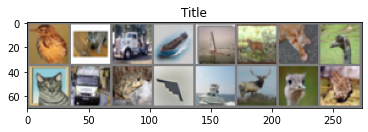

bird  cat   truck ship  ship  deer  cat   bird  cat   truck frog  plane ship  deer  bird  frog 


In [ ]:
dataiter = iter(trainloader)
images, labels = next(dataiter)
imshow(torchvision.utils.make_grid(images))
print(' '.join(f'{classes[labels[j]]:5s}' for j in range(batch_size)))

# Model VAE

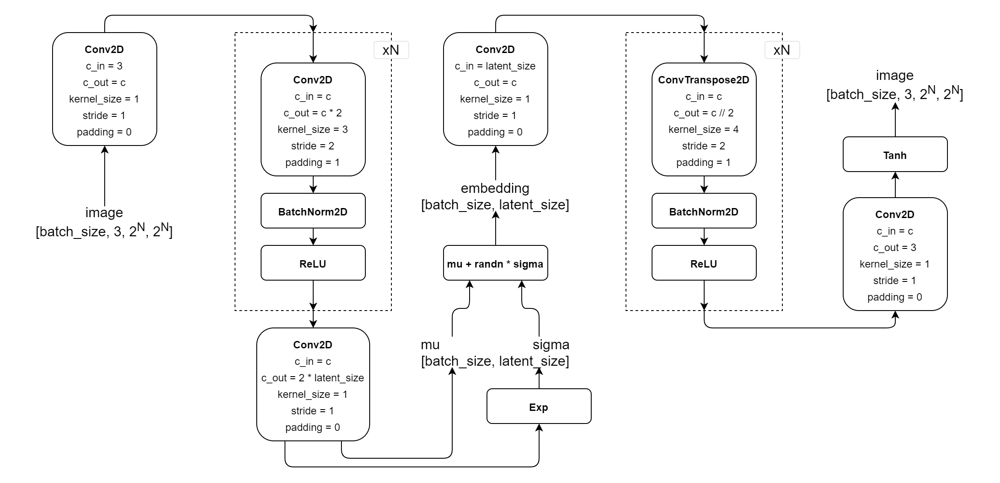

Стандарная модель VAE.

## Encoder

In [38]:
class Encoder(nn.Module):
    def __init__(self, img_size=32, downsamplings=3, latent_size=128, linear_hidden_size=256, down_channels=4):
        super().__init__()

        self.latent_size = latent_size
        self.downsamplings = downsamplings
        self.linear_hidden_size = linear_hidden_size    
        self.down_channels = down_channels

        n_channels = self.down_channels
        hidden_dims = [n_channels * 2 ** i for i in range(1, self.downsamplings + 1)]

        self.down_pipe = self.build_encoder(hidden_dims)

        if (img_size / 2 ** self.downsamplings) < 1:
            raise ValueError("Img size is too small or #downsaplings is too big.")

        down_final_size = (img_size // 2**self.downsamplings) ** 2 * self.linear_hidden_size

        self.fc1_mu = nn.Linear(down_final_size, self.linear_hidden_size)
        self.fc1_sigma = nn.Linear(down_final_size, self.linear_hidden_size)
        self.fc2_mu = nn.Linear(self.linear_hidden_size, self.latent_size)
        self.fc2_sigma = nn.Linear(self.linear_hidden_size, self.latent_size)
    
    def forward(self, x):
        enc_x = self.down_pipe(x)
        enc_x = torch.flatten(enc_x, start_dim=1)
        mu = self.fc2_mu(torch.relu(self.fc1_mu(enc_x)))
        log_var = self.fc2_sigma(torch.relu(self.fc1_sigma(enc_x)))
        std = torch.exp(log_var)
        eps = torch.randn_like(std)
        kld = 0.5 * (log_var.exp() + mu ** 2 - log_var - 1)
        return eps * std + mu, kld

    
    def build_encoder(self, hidden_dims: tp.List[int]) -> nn.Sequential:
        in_channels = 3
        modules = []

        modules.append(
            nn.Conv2d(
                in_channels, 
                self.down_channels,
                kernel_size=1,
                stride=1,
                padding=0,
            )
        )

        in_channels = self.down_channels
        for h_dim in hidden_dims:
            modules.append(
                nn.Sequential(
                    nn.Conv2d(in_channels,
                              out_channels=h_dim,
                              kernel_size=3,
                              stride=2,
                              padding=1,
                        ),
                    nn.BatchNorm2d(h_dim),
                    nn.LeakyReLU(),
                )
            )
            in_channels = h_dim

        modules.append(
            nn.Conv2d(
                hidden_dims[-1],
                self.linear_hidden_size,
                kernel_size=1,
                stride=1, 
                padding=0
            )
        )

        return nn.Sequential(*modules)
        


### Check

In [ ]:
tenc = Encoder()
print(tenc)

Encoder(
  (down_pipe): Sequential(
    (0): Conv2d(3, 4, kernel_size=(1, 1), stride=(1, 1))
    (1): Sequential(
      (0): Conv2d(4, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (2): Sequential(
      (0): Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (3): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (4): Conv2d(32, 256, kernel_size=(1, 1), stride=(1, 1))
  )
  (fc1_mu): Linear(in_features=4096, out_features=256, bias=True)
  (fc1_sigma): Linear(in_features=4096, out_features=256, bias=True)
 

In [ ]:
summary(tenc, (3, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 32, 32]              16
            Conv2d-2            [-1, 8, 16, 16]             296
       BatchNorm2d-3            [-1, 8, 16, 16]              16
         LeakyReLU-4            [-1, 8, 16, 16]               0
            Conv2d-5             [-1, 16, 8, 8]           1,168
       BatchNorm2d-6             [-1, 16, 8, 8]              32
         LeakyReLU-7             [-1, 16, 8, 8]               0
            Conv2d-8             [-1, 32, 4, 4]           4,640
       BatchNorm2d-9             [-1, 32, 4, 4]              64
        LeakyReLU-10             [-1, 32, 4, 4]               0
           Conv2d-11            [-1, 256, 4, 4]           8,448
           Linear-12                  [-1, 256]       1,048,832
           Linear-13                  [-1, 128]          32,896
           Linear-14                  [

## Decoder

In [39]:
class Decoder(nn.Module):
    def __init__(self, img_size=32, upsamplings=3, latent_size=128, linear_hidden_size=256, up_channels=8):
        super().__init__()

        self.latent_size = latent_size
        self.upsamplings = upsamplings
        self.linear_hidden_size = linear_hidden_size    
        self.up_channels = up_channels

        self.img_down_size = img_size // 2**self.upsamplings

        if self.img_down_size * 2 ** self.upsamplings != img_size:
            raise ValueError("Final img size != img_size after decoding.")

        up_start_size = self.img_down_size ** 2 * self.linear_hidden_size

        if latent_size < up_start_size // 2:
            self.decoder_fc = nn.Sequential(
                nn.Linear(latent_size, up_start_size // 2),
                nn.ReLU(),
                nn.Linear(up_start_size // 2, up_start_size),
            )
        else:
            self.decoder_fc = nn.Linear(latent_size, up_start_size)
        
        self.up_pipe = self.build_decoder()
    
    def forward(self, embed):
        x_dec = self.decoder_fc(embed)
        x_dec = x_dec.view(-1, self.linear_hidden_size, self.img_down_size, self.img_down_size)
        x_dec = self.up_pipe(x_dec)
        return torch.tanh(x_dec)

    
    def build_decoder(self):
        hidden_dims = [self.up_channels * 2 ** i for i in range(self.upsamplings)]
        hidden_dims.reverse()
        prev_dim = self.linear_hidden_size
        modules = []

        for next_dim in hidden_dims:
            modules.append(
                nn.Sequential(
                    nn.ConvTranspose2d(
                        prev_dim,
                        next_dim,
                        kernel_size=4,
                        stride=2,
                        padding=1
                    ),
                    nn.BatchNorm2d(next_dim),
                    nn.LeakyReLU()
                )
            )
            prev_dim = next_dim
        
        modules.append(nn.Conv2d(self.up_channels, 3, 1, 1, 0))
        
        return nn.Sequential(*modules)



### Check

In [ ]:
tdec = Decoder()
print(tdec)

Decoder(
  (decoder_fc): Sequential(
    (0): Linear(in_features=128, out_features=2048, bias=True)
    (1): ReLU()
    (2): Linear(in_features=2048, out_features=4096, bias=True)
  )
  (up_pipe): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(256, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (1): Sequential(
      (0): ConvTranspose2d(32, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (2): Sequential(
      (0): ConvTranspose2d(16, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.01)
    )
    (3): Conv2d(8, 3, kernel_size=(1, 1), stride=(1, 1

In [ ]:
summary(tdec, (128,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 2048]         264,192
              ReLU-2                 [-1, 2048]               0
            Linear-3                 [-1, 4096]       8,392,704
   ConvTranspose2d-4             [-1, 32, 8, 8]         131,104
       BatchNorm2d-5             [-1, 32, 8, 8]              64
         LeakyReLU-6             [-1, 32, 8, 8]               0
   ConvTranspose2d-7           [-1, 16, 16, 16]           8,208
       BatchNorm2d-8           [-1, 16, 16, 16]              32
         LeakyReLU-9           [-1, 16, 16, 16]               0
  ConvTranspose2d-10            [-1, 8, 32, 32]           2,056
      BatchNorm2d-11            [-1, 8, 32, 32]              16
        LeakyReLU-12            [-1, 8, 32, 32]               0
           Conv2d-13            [-1, 3, 32, 32]              27
Total params: 8,798,403
Trainable param

In [ ]:
v = torch.normal(0, 1, size=(8,128))
dec = tdec(v)


In [ ]:
dec.detach().numpy().shape

(8, 3, 32, 32)

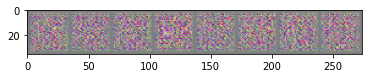

In [ ]:
imshow(torchvision.utils.make_grid(dec.detach()))

##Autoencoder

In [40]:
class VAE(nn.Module):
    def __init__(self, img_size=32, downsamplings=3, latent_size=128, linear_hidden_size=256, down_channels=4, up_channels=8):
        super().__init__()

        self.latent_size = latent_size
        self.downsamplings = downsamplings
        self.linear_hidden_size = linear_hidden_size    
        self.down_channels = down_channels
        self.up_channels = up_channels

        self.encoder = Encoder(
            img_size=img_size,
            downsamplings=downsamplings,
            latent_size=latent_size,
            linear_hidden_size=linear_hidden_size,
            down_channels=down_channels,
        )

        self.decoder = Decoder(
            img_size=img_size,
            upsamplings=downsamplings,
            latent_size=latent_size,
            linear_hidden_size=linear_hidden_size,
            up_channels=up_channels,
        )

        
    def forward(self, x):
        z, kld = self.encoder(x)
        x_pred = self.decoder(z)
        return x_pred, kld

###Check

In [ ]:
tvae = VAE()
print(tvae)

VAE(
  (encoder): Encoder(
    (down_pipe): Sequential(
      (0): Conv2d(3, 4, kernel_size=(1, 1), stride=(1, 1))
      (1): Sequential(
        (0): Conv2d(4, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.01)
      )
      (2): Sequential(
        (0): Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.01)
      )
      (3): Sequential(
        (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.01)
      )
      (4): Conv2d(32, 256, kernel_size=(1, 1), stride=(1, 1))
    )
    (fc1_mu): Linear(in_features=4096, out_features=256, bias=True)
    (fc1_sig

In [ ]:
summary(tvae, (3, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 32, 32]              16
            Conv2d-2            [-1, 8, 16, 16]             296
       BatchNorm2d-3            [-1, 8, 16, 16]              16
         LeakyReLU-4            [-1, 8, 16, 16]               0
            Conv2d-5             [-1, 16, 8, 8]           1,168
       BatchNorm2d-6             [-1, 16, 8, 8]              32
         LeakyReLU-7             [-1, 16, 8, 8]               0
            Conv2d-8             [-1, 32, 4, 4]           4,640
       BatchNorm2d-9             [-1, 32, 4, 4]              64
        LeakyReLU-10             [-1, 32, 4, 4]               0
           Conv2d-11            [-1, 256, 4, 4]           8,448
           Linear-12                  [-1, 256]       1,048,832
           Linear-13                  [-1, 128]          32,896
           Linear-14                  [

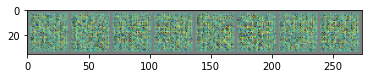

In [ ]:
v = torch.normal(0, 1, size=(8, 3, 32, 32))
dec, _ = tvae(v)
imshow(torchvision.utils.make_grid(dec.detach()))

## Utils

In [41]:
def show_example(model: nn.Module, train_imgs: torch.Tensor, test_imgs: torch.Tensor):
    with torch.no_grad():
        train_rec_img, _ = model(train_imgs)
        test_rec_img, _ = model(test_imgs)

        imshow(torchvision.utils.make_grid(train_imgs.cpu()), "Original Train")
        imshow(torchvision.utils.make_grid(train_rec_img.cpu()), "Reconstructed train")

        imshow(torchvision.utils.make_grid(test_imgs.cpu()), "Original Test")
        imshow(torchvision.utils.make_grid(test_rec_img.cpu()), "Reconstructed test")

In [ ]:
dataiter = iter(trainloader)
train_img, _ = next(dataiter)

dataiter = iter(testloader)
test_img, _ = next(dataiter)

show_example(tvae, train_img, test_img)

NameError: ignored

## Train

Loss для VAE состоит из 2 частей: reconstruction loss и kl-divergence. В качестве первого я решил использовать mse и попробовать log(cosh) из [этой статьи.](https://openreview.net/pdf?id=rkglvsC9Ym)

In [10]:
def mse_loss(rec_img, img):
    return ((rec_img - img)**2).sum()

def logcosh_loss(rec_img: torch.Tensor, img: torch.Tensor, alpha: float = 25.):
    cosh = torch.cosh(alpha * (img - rec_img))
    return (1. / alpha * torch.log(cosh + 1e-12)).sum()

In [43]:
import typing as tp

def train_vae(
    model: nn.Module,
    optim: Optimizer,
    device: tp.Any,
    reconstruction_loss_func: tp.Callable,
    trainloader: DataLoader,
    testloader: DataLoader,
    kld_lambda: float = 0.1,
    epochs = 20,
    verbose_ep = 10,
    **loss_kwargs,
) -> tp.Tuple[tp.List[float], tp.List[float]]:
    model.to(device)
    train_batch_size = trainloader.batch_size
    test_batch_size = testloader.batch_size

    train_loss_history = []
    test_loss_history = []

    dataiter = iter(trainloader)
    train_img, _ = next(dataiter)

    dataiter = iter(testloader)
    test_img, _ = next(dataiter)

    show_example(model, train_img.to(device), test_img.to(device))

    for ep in range(1, epochs + 1):
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0
        fin_loss = 0

        model.train()

        for batch, _ in tqdm(trainloader):
            total_batches += 1
            img = batch.to(device)
            rec_img, kld = model(img)
            kld_loss = kld.sum() / train_batch_size
            rec_loss = reconstruction_loss_func(rec_img, img, **loss_kwargs) / train_batch_size
            loss = rec_loss + kld_lambda * kld_loss
            optim.zero_grad()
            loss.backward()
            optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()
            fin_loss = loss.item()

        train_loss_history.append(fin_loss)
        print(f"Epoch {ep} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

        model.eval()
        with torch.no_grad():
            total_batches = 0
            rec_loss_avg = 0
            kld_loss_avg = 0
            for batch, _ in tqdm(testloader):
                total_batches += 1
                img = batch.to(device)
                rec_img, kld = model(img)
                kld_loss = kld.sum() / test_batch_size
                rec_loss = reconstruction_loss_func(rec_img, img, **loss_kwargs) / test_batch_size
                kld_loss_avg += kld_loss.item()
                rec_loss_avg += rec_loss.item()
                loss = rec_loss + kld_lambda * kld_loss
                fin_loss = loss.item()
        
        test_loss_history.append(fin_loss)
        print(f"Epoch {ep} | Reconstruction test loss: {rec_loss_avg / total_batches} | KLD test loss: {kld_loss_avg / total_batches}")

        if ep % verbose_ep == 0:
            show_example(model, train_img.to(device), test_img.to(device))
        
    return train_loss_history, test_loss_history

In [ ]:
vae_model = VAE()
vae_optim = Adam(vae_model.parameters())
trainloader, testloader = create_loaders(trainset, testset)
print(device)

cuda


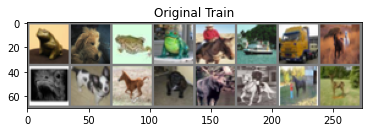

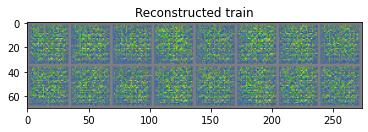

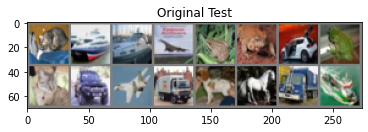

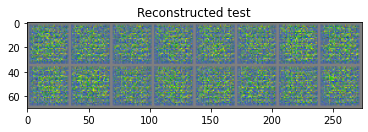

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 254.0504167529297 | KLD loss: 93.58163166545867


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 192.80572756347655 | KLD test loss: 101.18209036865234


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 176.51545021972657 | KLD loss: 100.67929251708985


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 157.0491897949219 | KLD test loss: 99.87006245117188


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 162.15420205322266 | KLD loss: 98.62399619140625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 145.0382124267578 | KLD test loss: 98.22125048828126


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 152.44692286621094 | KLD loss: 97.05931579833984


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 140.82155454101562 | KLD test loss: 94.024980859375


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 145.9680071484375 | KLD loss: 94.5909311328125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 136.32485169677733 | KLD test loss: 96.74751634521485


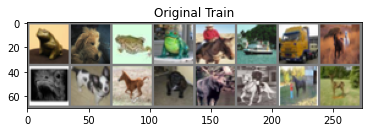

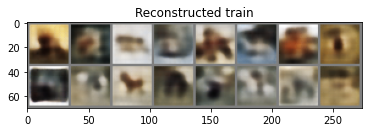

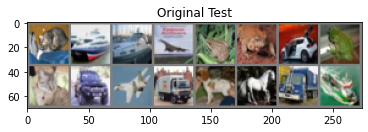

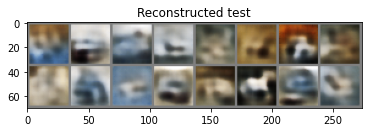

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 140.9434009716797 | KLD loss: 92.84728961181641


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 133.78571599121094 | KLD test loss: 88.26097473144532


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 138.04493898925782 | KLD loss: 89.69069760498047


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 137.58548864746095 | KLD test loss: 84.9152814086914


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 136.00630479003905 | KLD loss: 86.73996599853515


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 129.19286732177736 | KLD test loss: 85.79538671875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 134.5657487133789 | KLD loss: 84.25008741210938


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 137.56175690917968 | KLD test loss: 83.73712889404297


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 133.4063175341797 | KLD loss: 82.43849001464844


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 128.1026291503906 | KLD test loss: 81.90544267578125


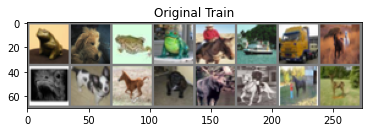

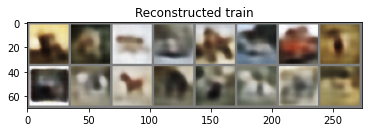

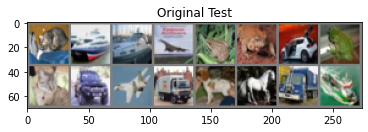

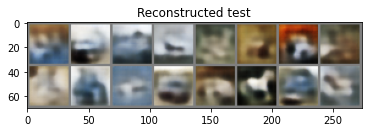

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 131.38117619140624 | KLD loss: 81.79364291992188


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 11 | Reconstruction test loss: 124.27705279541016 | KLD test loss: 81.04716472167969


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 128.98957861572265 | KLD loss: 80.77678002197266


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 12 | Reconstruction test loss: 123.38952436523438 | KLD test loss: 78.84858671875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 127.50096821777343 | KLD loss: 79.82893278808594


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 13 | Reconstruction test loss: 122.99447352294922 | KLD test loss: 78.52441456298828


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 126.43038080566406 | KLD loss: 79.01658719482423


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 14 | Reconstruction test loss: 123.1225627319336 | KLD test loss: 79.15733291015626


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 125.10699432128906 | KLD loss: 79.25423465332031


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 15 | Reconstruction test loss: 122.11561024169922 | KLD test loss: 78.5357357421875


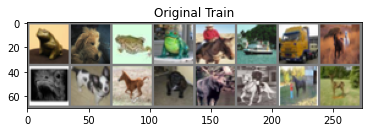

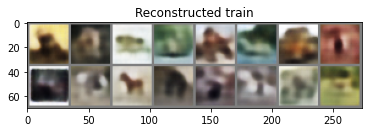

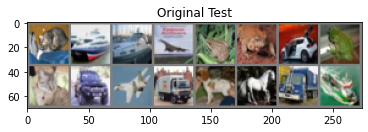

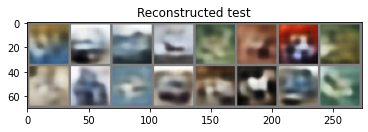

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 123.77433572509766 | KLD loss: 78.79910684326173


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 16 | Reconstruction test loss: 120.66376276855469 | KLD test loss: 78.9161999633789


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 122.19762105712891 | KLD loss: 78.59252754882813


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 17 | Reconstruction test loss: 121.49026336669922 | KLD test loss: 78.48165206298827


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 121.4671697998047 | KLD loss: 78.07371697753906


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 18 | Reconstruction test loss: 118.8180052368164 | KLD test loss: 77.90178713378906


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 120.71843822265625 | KLD loss: 77.63554474365235


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 19 | Reconstruction test loss: 120.64696431884765 | KLD test loss: 77.53879747314453


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 120.41062526123046 | KLD loss: 77.49852843505859


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 20 | Reconstruction test loss: 119.4871624267578 | KLD test loss: 77.41751173095703


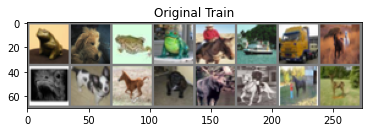

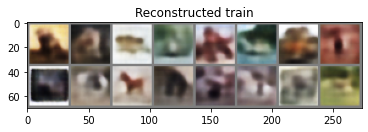

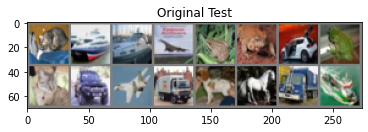

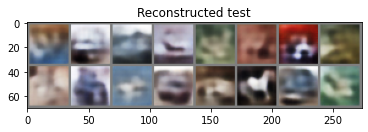

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 119.65492112792968 | KLD loss: 77.17719272216797


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 21 | Reconstruction test loss: 118.07065150146484 | KLD test loss: 76.01506770019532


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 119.18002310546875 | KLD loss: 76.96658771728515


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 22 | Reconstruction test loss: 120.04971185302735 | KLD test loss: 77.76419735107422


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 118.67017914794921 | KLD loss: 76.74763529296875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 23 | Reconstruction test loss: 118.21806520996094 | KLD test loss: 75.58161545410157


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 118.18842502685547 | KLD loss: 76.41266930419921


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 24 | Reconstruction test loss: 118.56443854980469 | KLD test loss: 76.1271716430664


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 117.82458046875 | KLD loss: 76.21381319580078


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 25 | Reconstruction test loss: 117.45376115722657 | KLD test loss: 76.4962296508789


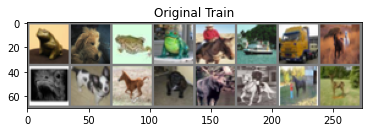

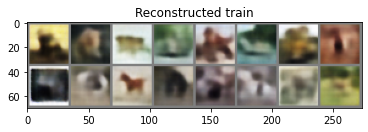

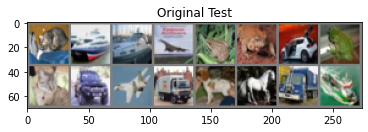

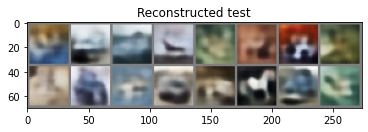

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 117.3578990649414 | KLD loss: 76.11602318115234


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 26 | Reconstruction test loss: 116.89119604492187 | KLD test loss: 74.88598482666016


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 116.49774745361329 | KLD loss: 76.22229564941406


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 27 | Reconstruction test loss: 115.82318881835937 | KLD test loss: 76.15813204345703


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 115.75065645507813 | KLD loss: 76.2007926953125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 28 | Reconstruction test loss: 115.94413726806641 | KLD test loss: 75.29152329101562


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 115.27346544677734 | KLD loss: 75.92973771972656


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 29 | Reconstruction test loss: 115.53703338623046 | KLD test loss: 75.5061646850586


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 114.85870781738281 | KLD loss: 75.77151736816407


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 30 | Reconstruction test loss: 116.46910834960937 | KLD test loss: 75.21696005859376


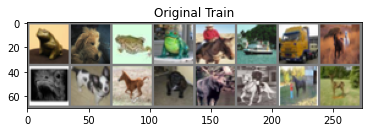

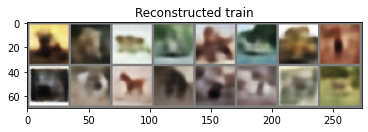

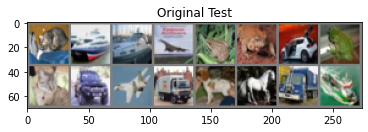

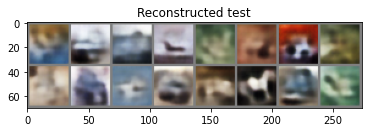

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 114.40636367431641 | KLD loss: 75.5849325415039


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 31 | Reconstruction test loss: 116.08303060302734 | KLD test loss: 75.02831616210938


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 114.11313578857421 | KLD loss: 75.43859589355469


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 32 | Reconstruction test loss: 115.86206489257812 | KLD test loss: 74.5600886352539


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 113.52087686523437 | KLD loss: 75.23222091796875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 33 | Reconstruction test loss: 115.78002260742187 | KLD test loss: 74.01337924804687


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 113.26665074951173 | KLD loss: 75.10409499023437


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 34 | Reconstruction test loss: 115.40869168701172 | KLD test loss: 73.92400977783203


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 112.81553506591797 | KLD loss: 74.98527971923828


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 35 | Reconstruction test loss: 116.74278898925782 | KLD test loss: 74.97665123291016


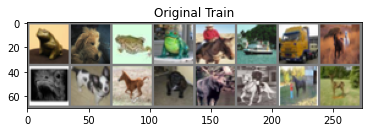

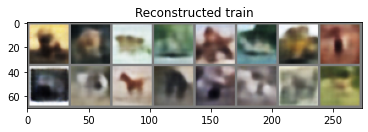

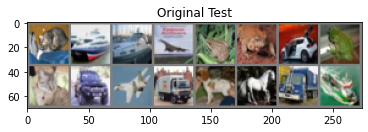

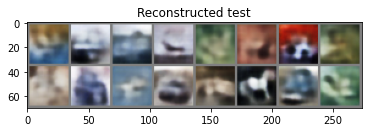

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 112.60120850341796 | KLD loss: 74.89615585205078


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 36 | Reconstruction test loss: 116.94688751220703 | KLD test loss: 73.49583984375


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 112.30053379150391 | KLD loss: 74.82435867675781


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 37 | Reconstruction test loss: 116.55987009277344 | KLD test loss: 74.31063685302735


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 111.71128004638672 | KLD loss: 74.79598833984375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 38 | Reconstruction test loss: 118.31825563964844 | KLD test loss: 73.0679580078125


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 111.46333333984374 | KLD loss: 74.68445383789063


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 39 | Reconstruction test loss: 115.8024591796875 | KLD test loss: 73.47224064941406


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 111.18254416748047 | KLD loss: 74.60038629638672


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 40 | Reconstruction test loss: 116.31029578857422 | KLD test loss: 74.14970515136719


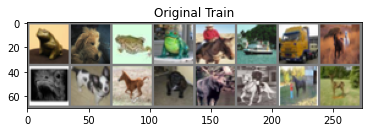

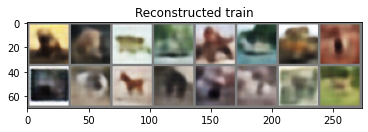

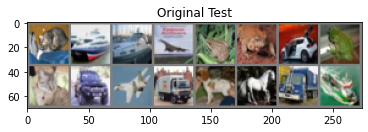

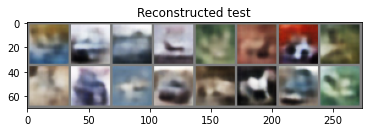

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 110.63126463623047 | KLD loss: 74.5846827734375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 41 | Reconstruction test loss: 120.6793723022461 | KLD test loss: 74.61669833984375


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 110.42914103759766 | KLD loss: 74.57126358886718


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 42 | Reconstruction test loss: 116.93746258544923 | KLD test loss: 72.87470229492187


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 110.0922826977539 | KLD loss: 74.5559883984375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 43 | Reconstruction test loss: 122.76107786865235 | KLD test loss: 74.44425823974609


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 109.50093990722657 | KLD loss: 75.01669012695312


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 44 | Reconstruction test loss: 117.123898046875 | KLD test loss: 76.610480859375


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 109.15102065185548 | KLD loss: 75.5111049609375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 45 | Reconstruction test loss: 117.77658701171875 | KLD test loss: 72.89048094482422


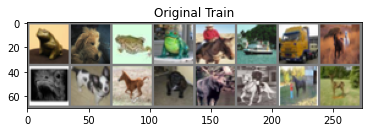

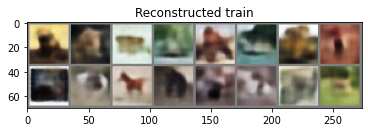

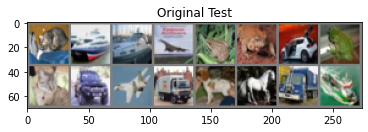

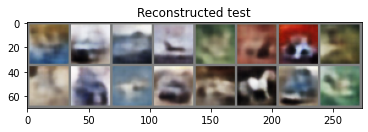

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 108.52395463623047 | KLD loss: 75.40331870849609


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 46 | Reconstruction test loss: 115.60305849609375 | KLD test loss: 74.07391528320312


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 108.06150482666015 | KLD loss: 75.25188039794922


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 47 | Reconstruction test loss: 119.25379028320313 | KLD test loss: 75.25338181152344


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 107.89936794921876 | KLD loss: 75.17150268066406


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 48 | Reconstruction test loss: 114.94599146728515 | KLD test loss: 75.25840268554687


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 107.48394501464844 | KLD loss: 75.12393634277343


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 49 | Reconstruction test loss: 115.89038615722656 | KLD test loss: 73.730625


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 107.08015758300782 | KLD loss: 75.00439464111328


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 50 | Reconstruction test loss: 116.3714782836914 | KLD test loss: 73.68938267822266


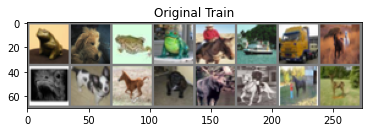

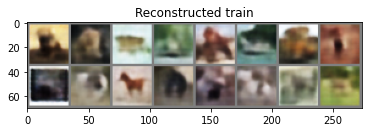

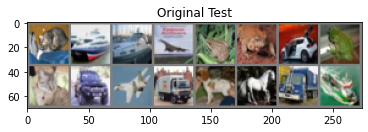

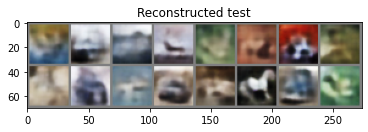

In [ ]:
train_loss, test_loss = train_vae(vae_model, vae_optim, device, mse_loss, trainloader, testloader, epochs=50, verbose_ep = 5)
torch.save(vae_model.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict50")

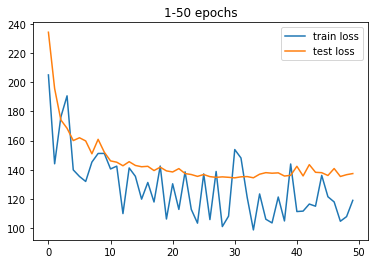

In [ ]:
plt.plot(train_loss, label="train loss")
plt.plot(test_loss, label="test loss")
plt.title("1-50 epochs")
plt.legend()
plt.show()

### Overfitting

In [ ]:
vae_model = VAE()
vae_model.load_state_dict(torch.load("/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict50"))

<All keys matched successfully>

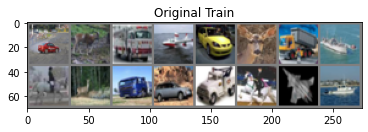

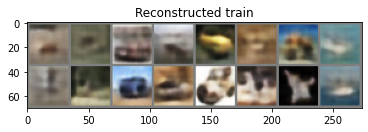

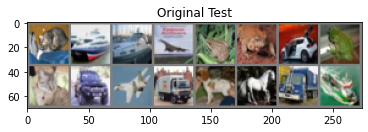

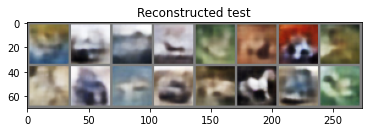

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 106.47669887451171 | KLD loss: 75.10558028320312


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 115.03943946533204 | KLD test loss: 74.82231196289062


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 106.27963882324218 | KLD loss: 75.46820177734375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 116.84597147216797 | KLD test loss: 72.52508172607422


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 105.69026660888672 | KLD loss: 75.4414677319336


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 114.62511882324219 | KLD test loss: 74.59700491943359


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 105.25889958251953 | KLD loss: 75.43331129394531


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 115.77433115234375 | KLD test loss: 74.94617520751953


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 104.94831908691407 | KLD loss: 75.45790251708985


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 115.442057421875 | KLD test loss: 75.86490505371094


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 104.37329558349609 | KLD loss: 75.54209888427734


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 115.71861066894532 | KLD test loss: 74.7872748046875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 104.07185233398438 | KLD loss: 75.53193182861328


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 115.25544555664062 | KLD test loss: 74.24507352294921


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 103.73685660766601 | KLD loss: 75.64422094482421


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 114.6583896850586 | KLD test loss: 75.84882392578125


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 103.28714713623047 | KLD loss: 75.63988435546875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 114.65970953369141 | KLD test loss: 74.75355404052735


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 103.14417495605468 | KLD loss: 75.69753619873048


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 116.20346031494141 | KLD test loss: 75.81901440429688


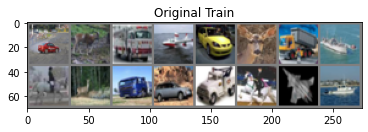

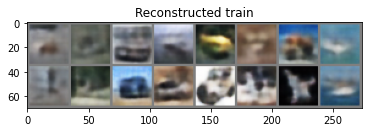

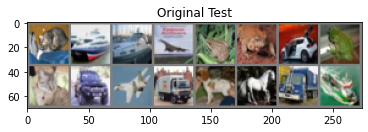

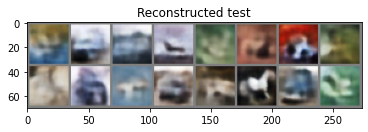

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 102.82701242919921 | KLD loss: 75.74443872802735


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 11 | Reconstruction test loss: 118.0559056274414 | KLD test loss: 75.58860294189454


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 102.480552578125 | KLD loss: 75.80616784179688


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 12 | Reconstruction test loss: 116.470259375 | KLD test loss: 76.49571137695312


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 102.19399399902343 | KLD loss: 75.94132064697266


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 13 | Reconstruction test loss: 115.74030358886719 | KLD test loss: 74.86296726074218


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 101.8887932055664 | KLD loss: 75.98878705810547


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 14 | Reconstruction test loss: 115.77248760986328 | KLD test loss: 76.4310666381836


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 101.57177744140625 | KLD loss: 75.90830309814453


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 15 | Reconstruction test loss: 115.55279245605469 | KLD test loss: 76.81374841308593


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 101.25548918701172 | KLD loss: 75.9122358984375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 16 | Reconstruction test loss: 115.0143596069336 | KLD test loss: 77.42525856933594


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 101.16099210693359 | KLD loss: 76.05539637695313


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 17 | Reconstruction test loss: 116.76785444335937 | KLD test loss: 76.1106521850586


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 100.58892788085937 | KLD loss: 76.03335657226563


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 18 | Reconstruction test loss: 115.305582421875 | KLD test loss: 74.56587215576172


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 100.56878501708984 | KLD loss: 76.12776283203125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 19 | Reconstruction test loss: 116.28105209960937 | KLD test loss: 75.39073029785156


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 100.22994419189453 | KLD loss: 76.16481572509765


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 20 | Reconstruction test loss: 115.97761884765625 | KLD test loss: 77.16644428710937


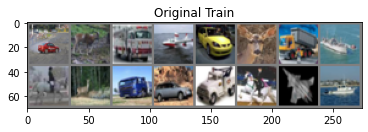

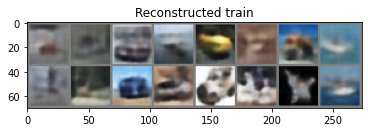

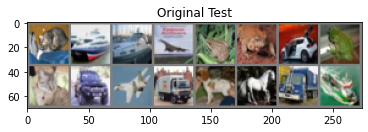

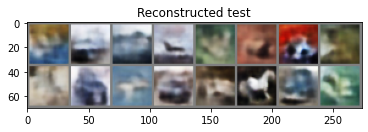

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 99.93257496582031 | KLD loss: 76.16752939453124


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 21 | Reconstruction test loss: 116.03433934326172 | KLD test loss: 76.22237053222656


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 99.86260797119141 | KLD loss: 76.22114439453125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 22 | Reconstruction test loss: 115.74551949462891 | KLD test loss: 75.0417196899414


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 99.41630418212891 | KLD loss: 76.22708353271484


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 23 | Reconstruction test loss: 120.22336696777344 | KLD test loss: 76.60207137451172


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 99.29204501953124 | KLD loss: 76.17692194335937


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 24 | Reconstruction test loss: 116.16197934570313 | KLD test loss: 74.61086033935547


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 98.96271764770508 | KLD loss: 76.26863533203125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 25 | Reconstruction test loss: 115.82348118896485 | KLD test loss: 76.81685789794922


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 98.77352815551758 | KLD loss: 76.31772306152344


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 26 | Reconstruction test loss: 115.77652507324218 | KLD test loss: 75.54492185058594


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 98.57013904785157 | KLD loss: 76.30334583251953


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 27 | Reconstruction test loss: 117.12642958984375 | KLD test loss: 75.95166688232422


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 98.31411408935547 | KLD loss: 76.37048911376954


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 28 | Reconstruction test loss: 116.56150565185547 | KLD test loss: 75.68393454589844


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 98.06010896972656 | KLD loss: 76.41950777587891


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 29 | Reconstruction test loss: 116.50692573242188 | KLD test loss: 75.90585206298829


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 97.80752270751952 | KLD loss: 76.40333807128906


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 30 | Reconstruction test loss: 117.3627091796875 | KLD test loss: 75.16566784667968


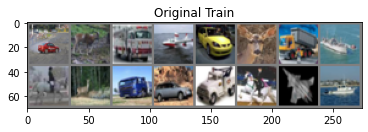

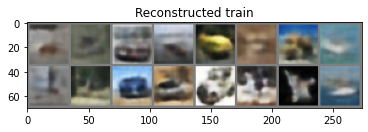

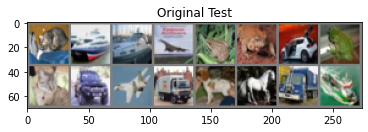

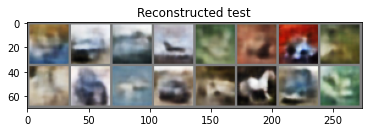

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 97.6454216015625 | KLD loss: 76.45987494140626


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 31 | Reconstruction test loss: 119.34529965820313 | KLD test loss: 77.52372231445312


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 97.29238348876953 | KLD loss: 76.45101443603515


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 32 | Reconstruction test loss: 118.54139926757813 | KLD test loss: 75.33777995605469


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 97.06756267089844 | KLD loss: 76.3951080444336


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 33 | Reconstruction test loss: 116.77347862548828 | KLD test loss: 75.02267962646485


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 96.87256477294922 | KLD loss: 76.51683875732422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 34 | Reconstruction test loss: 116.60223385009766 | KLD test loss: 76.03503686523437


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 96.7001623828125 | KLD loss: 76.51171924560546


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 35 | Reconstruction test loss: 118.66494077148438 | KLD test loss: 76.2585873413086


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 96.4540566772461 | KLD loss: 76.50437223144532


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 36 | Reconstruction test loss: 117.11617711181641 | KLD test loss: 76.68045057373047


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 96.3334703125 | KLD loss: 76.51812035644531


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 37 | Reconstruction test loss: 118.53693065185547 | KLD test loss: 75.87284787597656


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 96.03511149902344 | KLD loss: 76.78051598388672


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 38 | Reconstruction test loss: 118.45362713623047 | KLD test loss: 77.58100344238281


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 95.61852716796875 | KLD loss: 77.32735509765625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 39 | Reconstruction test loss: 118.12177182617188 | KLD test loss: 77.15767602539063


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 95.47015275146484 | KLD loss: 77.44283336669922


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 40 | Reconstruction test loss: 116.42843428955078 | KLD test loss: 76.98868837890625


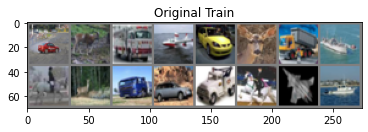

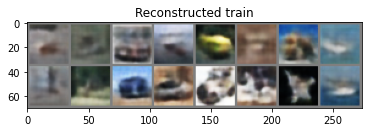

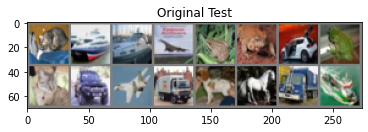

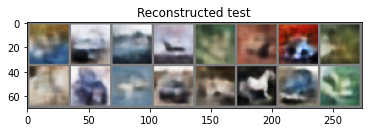

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 95.21839913330078 | KLD loss: 77.40285990722656


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 41 | Reconstruction test loss: 119.06360675048828 | KLD test loss: 76.72648079833985


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 94.99845806152344 | KLD loss: 77.35636110107421


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 42 | Reconstruction test loss: 117.10951469726562 | KLD test loss: 77.01109230957032


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 94.54565915405273 | KLD loss: 77.3164212084961


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 43 | Reconstruction test loss: 117.07997536621093 | KLD test loss: 77.49685100097656


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 94.42058678710937 | KLD loss: 77.30752405761719


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 44 | Reconstruction test loss: 116.88576376953125 | KLD test loss: 77.13655078125


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 94.28030771728515 | KLD loss: 77.36800040771485


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 45 | Reconstruction test loss: 118.24559407958985 | KLD test loss: 77.42186411132812


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 93.990200625 | KLD loss: 77.38186970458985


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 46 | Reconstruction test loss: 119.44594737548829 | KLD test loss: 78.29657329101562


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 93.82388696166993 | KLD loss: 77.40247592285156


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 47 | Reconstruction test loss: 120.39316094970704 | KLD test loss: 77.29331422119141


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 93.70523524658203 | KLD loss: 77.46683759765625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 48 | Reconstruction test loss: 118.12792667236329 | KLD test loss: 77.7565741821289


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 93.43827715332031 | KLD loss: 77.55101434570312


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 49 | Reconstruction test loss: 120.08998038330078 | KLD test loss: 76.04319146728515


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 93.23800119995117 | KLD loss: 77.41361392822266


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 50 | Reconstruction test loss: 120.11703690185547 | KLD test loss: 77.7335139038086


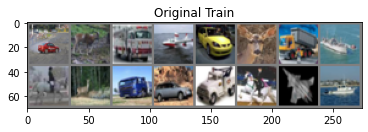

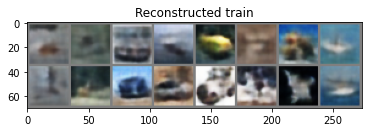

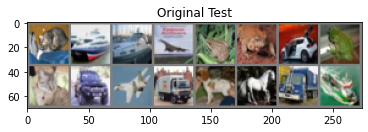

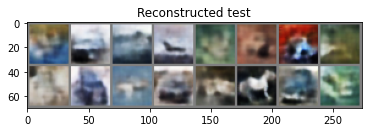

In [ ]:
vae_optim = Adam(vae_model.parameters(), lr=1e-3)
train_loss, test_loss = train_vae(vae_model, vae_optim, device, trainloader, testloader, epochs=50, verbose_ep = 10)
torch.save(vae_model.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict100")

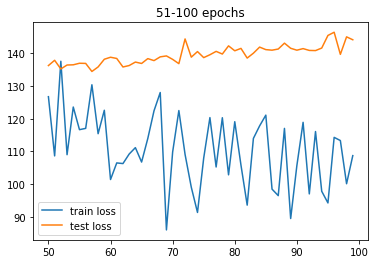

In [ ]:
epoch = list(range(50, 100))
plt.plot(epoch, train_loss, label="train loss")
plt.plot(epoch, test_loss, label="test loss")
plt.title("51-100 epochs")
plt.legend()
plt.show()

# Small Model VAE

In [ ]:
small_vae = VAE(img_size=32, downsamplings=3, latent_size=64, linear_hidden_size=128, down_channels=4, up_channels=4)
vae_optim = Adam(small_vae.parameters())
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
trainloader, testloader = create_loaders(trainset, testset)
print(device)

cuda


In [ ]:
summary(small_vae.to(device), (3, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 4, 32, 32]              16
            Conv2d-2            [-1, 8, 16, 16]             296
       BatchNorm2d-3            [-1, 8, 16, 16]              16
         LeakyReLU-4            [-1, 8, 16, 16]               0
            Conv2d-5             [-1, 16, 8, 8]           1,168
       BatchNorm2d-6             [-1, 16, 8, 8]              32
         LeakyReLU-7             [-1, 16, 8, 8]               0
            Conv2d-8             [-1, 32, 4, 4]           4,640
       BatchNorm2d-9             [-1, 32, 4, 4]              64
        LeakyReLU-10             [-1, 32, 4, 4]               0
           Conv2d-11            [-1, 128, 4, 4]           4,224
           Linear-12                  [-1, 128]         262,272
           Linear-13                   [-1, 64]           8,256
           Linear-14                  [

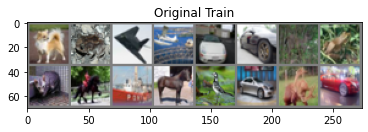

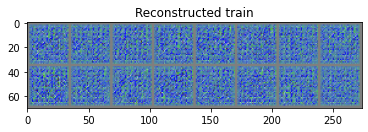

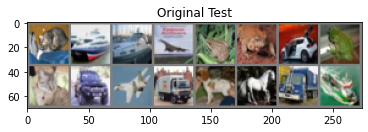

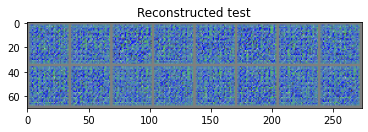

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 263.3091273779297 | KLD loss: 68.63472294559479


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 168.81400295410157 | KLD test loss: 76.06456876220703


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 172.77026422851563 | KLD loss: 76.09870348144531


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 148.0246881225586 | KLD test loss: 73.75465694580078


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 158.20194924316405 | KLD loss: 77.33639000976562


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 140.69226650390624 | KLD test loss: 81.39634125976562


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 150.76833040527345 | KLD loss: 77.55320138671875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 136.22895446777343 | KLD test loss: 76.79697064208985


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 145.29666273681642 | KLD loss: 77.59091099365234


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 139.26097260742188 | KLD test loss: 77.04615266113281


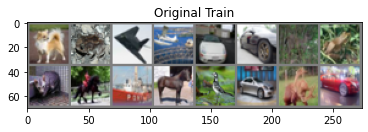

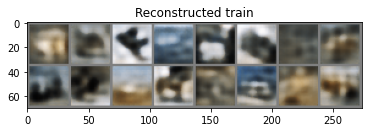

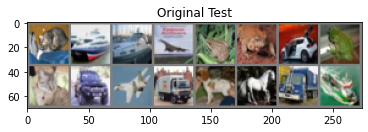

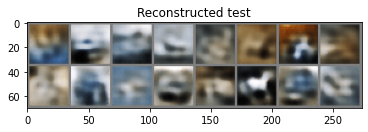

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 140.6023645239258 | KLD loss: 77.83943524902344


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 146.29132548828125 | KLD test loss: 77.82467379150391


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 136.00153268554686 | KLD loss: 78.20699300292969


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 128.82580544433594 | KLD test loss: 77.19733293457031


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 132.81149115722656 | KLD loss: 78.30397725830078


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 125.26179920654297 | KLD test loss: 77.62740123291016


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 130.7529112084961 | KLD loss: 78.23682531982422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 121.1945963623047 | KLD test loss: 78.00774611816406


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 128.9786472216797 | KLD loss: 78.21819126953125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 120.91700712890625 | KLD test loss: 75.88826138916015


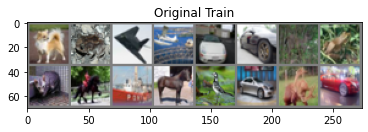

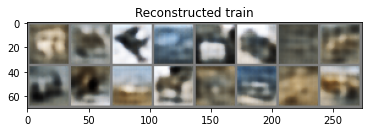

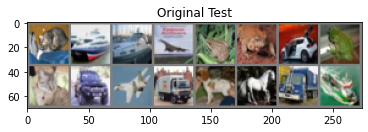

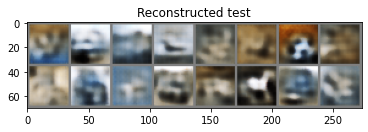

In [ ]:
train_loss, test_loss = train_vae(small_vae, vae_optim, device, mse_loss, trainloader, testloader, epochs=10, verbose_ep = 5)
torch.save(small_vae.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/smaller_vae_state_dict50")

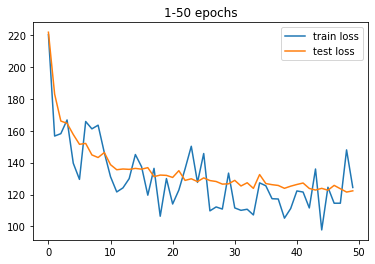

In [ ]:
plt.plot(train_loss, label="train loss")
plt.plot(test_loss, label="test loss")
plt.title("1-50 epochs")
plt.legend()
plt.show()

Далее я так же пробовал обучать больше 50 эпох, но к сожалению сломался ноутбук и не сохранилось ничего. Но если суммировать, то модель просто не учиться больше.

# LogCosh Loss Model

In [ ]:
logcosh_vae = VAE()
vae_optim = Adam(logcosh_vae.parameters())
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


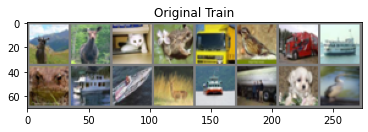

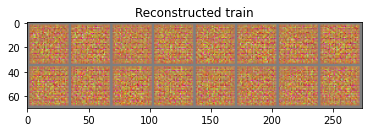

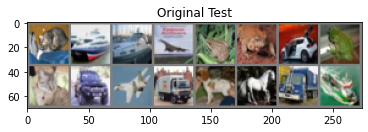

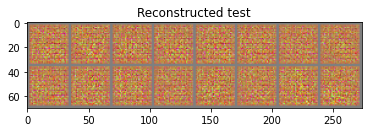

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 622.9031156738281 | KLD loss: 111.33228905532837


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 495.6614324707031 | KLD test loss: 119.19290565185547


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 487.2484591015625 | KLD loss: 122.79222599609375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 447.3418347167969 | KLD test loss: 129.18998793945312


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 453.84016227539064 | KLD loss: 124.95806922851563


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 425.03607905273435 | KLD test loss: 129.60438154296875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 436.6198405175781 | KLD loss: 124.61288228515625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 418.9950935546875 | KLD test loss: 123.24289617919922


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 422.38469426757814 | KLD loss: 125.09463766357422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 407.48047729492185 | KLD test loss: 123.85073706054688


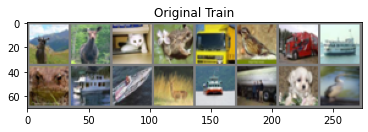

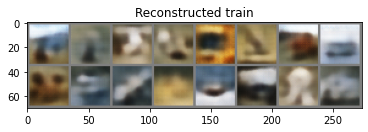

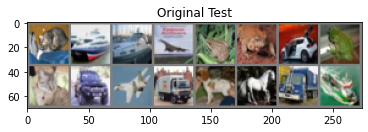

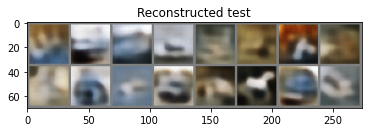

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 413.17732116210937 | KLD loss: 124.00214019042969


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 393.3728337890625 | KLD test loss: 118.598250390625


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 405.35391669921876 | KLD loss: 123.41091932373047


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 385.995719921875 | KLD test loss: 125.8263212524414


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 398.8261939746094 | KLD loss: 123.06892108154297


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 382.2203381347656 | KLD test loss: 125.75412778320313


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 394.638479140625 | KLD loss: 122.60724781982422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 377.9002060058594 | KLD test loss: 122.26586336669922


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 388.9836482128906 | KLD loss: 121.32066455566407


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 371.4013511230469 | KLD test loss: 120.20236634521484


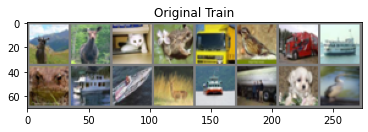

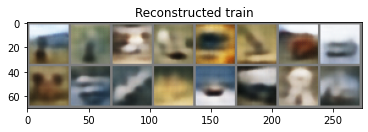

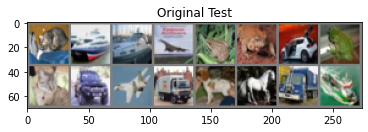

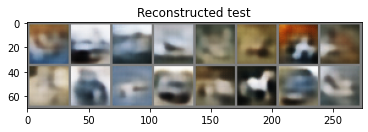

In [ ]:
train_loss, test_loss = train_vae(logcosh_vae, vae_optim, device, logcosh_loss, trainloader, testloader, epochs=10, verbose_ep = 5, alpha = 25.)

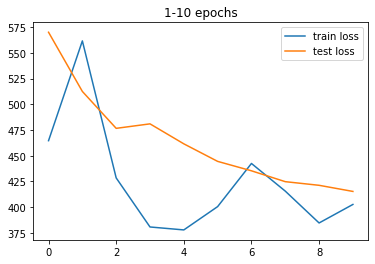

In [ ]:
plt.plot(train_loss, label="train loss")
plt.plot(test_loss, label="test loss")
plt.title("1-10 epochs")
plt.legend()
plt.show()

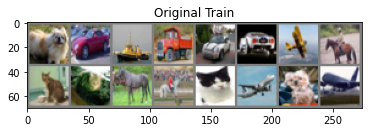

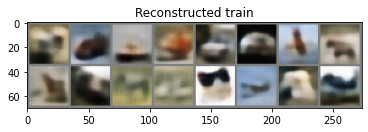

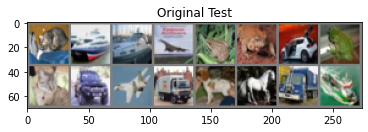

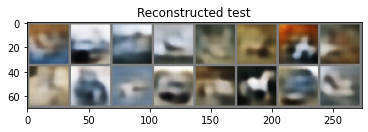

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 372.9809646386719 | KLD loss: 119.92372967773437


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 361.76507001953127 | KLD test loss: 118.70012829589844


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 370.904535234375 | KLD loss: 118.97451631591797


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 364.495353125 | KLD test loss: 117.855884375


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 369.0810803125 | KLD loss: 118.29379552978516


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 358.52997666015625 | KLD test loss: 118.11844187011718


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 368.02074655273435 | KLD loss: 118.11751028564453


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 357.533601953125 | KLD test loss: 116.72903656005859


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 366.62380927734375 | KLD loss: 117.64483159912109


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 364.10557739257814 | KLD test loss: 116.64893326416015


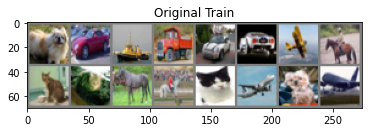

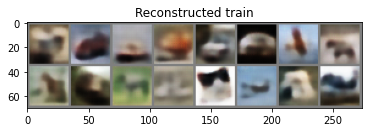

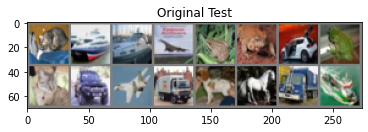

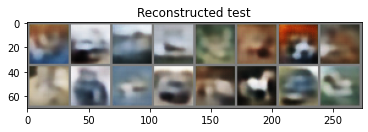

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 365.8341962011719 | KLD loss: 117.44730463378906


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 357.8921930175781 | KLD test loss: 116.18378638916016


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 364.96298125488283 | KLD loss: 117.27453860351562


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 357.0420059570312 | KLD test loss: 117.31579379882812


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 364.3380340722656 | KLD loss: 116.93881447265625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 361.54239794921875 | KLD test loss: 116.15754604492187


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 363.25515654296873 | KLD loss: 116.72799857177735


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 356.3221612792969 | KLD test loss: 115.99159404296876


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 362.78459278320315 | KLD loss: 116.56318935791016


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 353.98499858398435 | KLD test loss: 117.58483836669922


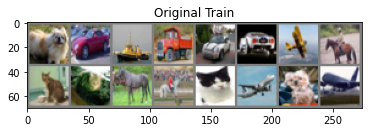

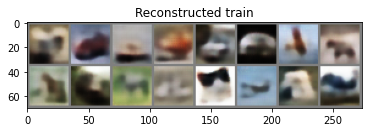

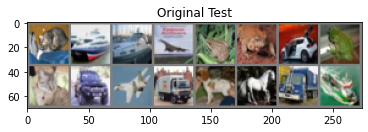

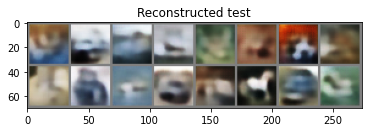

In [ ]:
vae_optim = Adam(logcosh_vae.parameters(), lr=1e-4)
train_loss, test_loss = train_vae(logcosh_vae, vae_optim, device, logcosh_loss, trainloader, testloader, epochs=10, verbose_ep = 5, alpha = 25.)


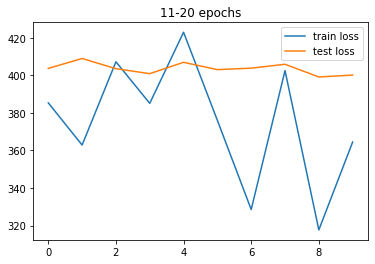

In [ ]:
plt.plot(train_loss, label="train loss")
plt.plot(test_loss, label="test loss")
plt.title("11-20 epochs")
plt.legend()
plt.show()

In [ ]:
torch.save(logcosh_vae.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/logcosh_vae_state_dict50")

# Add Augmentation

In [ ]:
augment_transform = transforms.Compose(
    [
        transforms.RandomCrop(32, padding=4, fill=128),
        transforms.RandomHorizontalFlip(), CIFAR10Policy(), transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ]
)

transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 16

trainset, testset, classes = load_data('./data', augment_transform, transform)
trainloader, testloader = create_loaders(trainset, testset)

<ipython-input-12-11e597d22ab3>:67: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  "posterize": np.round(np.linspace(8, 4, 10), 0).astype(np.int),


  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


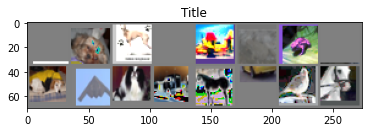

truck dog   dog   plane plane frog  frog  cat   dog   plane dog   truck horse car   bird  horse


In [ ]:
dataiter = iter(trainloader)
images, labels = next(dataiter)
imshow(torchvision.utils.make_grid(images))
print(' '.join(f'{classes[labels[j]]:5s}' for j in range(batch_size)))

## MSE

In [ ]:
vae_model = VAE()
vae_optim = Adam(vae_model.parameters())
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
trainloader, testloader = create_loaders(trainset, testset)
print(device)

cuda


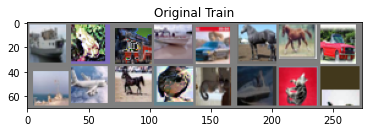

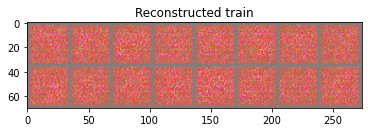

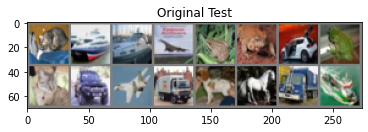

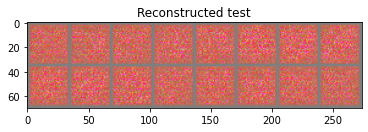

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 358.5003993212891 | KLD loss: 89.07972680793762


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 222.65257275390624 | KLD test loss: 101.28885125732423


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 254.58815551757812 | KLD loss: 99.08949758789062


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 176.29206882324218 | KLD test loss: 93.14071119384765


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 223.8293147241211 | KLD loss: 100.8551295751953


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 161.7430426147461 | KLD test loss: 100.80624503173829


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 211.89190907714843 | KLD loss: 98.4209323852539


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 159.9048469116211 | KLD test loss: 94.66039168701172


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 203.30528180664064 | KLD loss: 94.22095690917969


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 154.6629122680664 | KLD test loss: 92.71067252197265


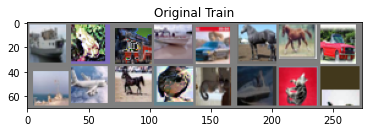

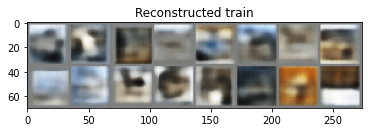

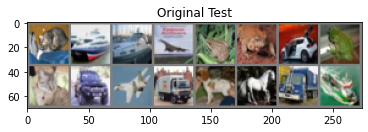

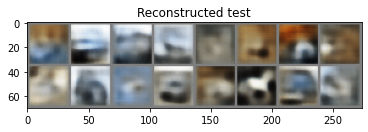

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 197.11852955322266 | KLD loss: 93.49777798583985


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 150.02001986083985 | KLD test loss: 92.37485372314453


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 192.86116584716797 | KLD loss: 90.25306237548828


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 149.95057314453126 | KLD test loss: 85.43857639160156


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 191.22535386962892 | KLD loss: 87.6688515600586


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 149.18989184570313 | KLD test loss: 86.02109438476562


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 190.14379058837892 | KLD loss: 85.69350274902344


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 149.93333751220703 | KLD test loss: 84.79133326416016


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 188.93803328613282 | KLD loss: 83.84078034423828


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 144.5090826904297 | KLD test loss: 78.24737502441407


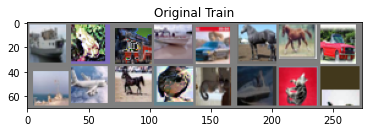

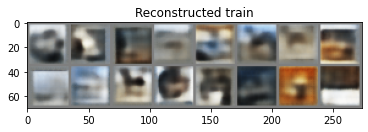

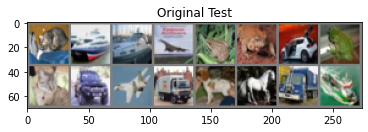

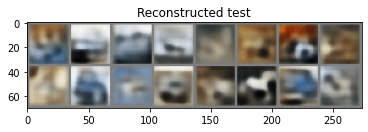

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 187.50986564453126 | KLD loss: 82.37659189697266


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 11 | Reconstruction test loss: 144.21965756835937 | KLD test loss: 79.18184090576172


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 185.8217275024414 | KLD loss: 80.97230784423829


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 12 | Reconstruction test loss: 144.20847846679686 | KLD test loss: 76.5775627319336


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 186.02347175292968 | KLD loss: 80.17468875732422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 13 | Reconstruction test loss: 143.5137616455078 | KLD test loss: 77.72060867919922


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 184.75644811523438 | KLD loss: 79.03933032226563


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 14 | Reconstruction test loss: 144.72648591308592 | KLD test loss: 77.73768278808593


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 183.9633897680664 | KLD loss: 78.97238934570312


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 15 | Reconstruction test loss: 141.19153151855468 | KLD test loss: 77.78387307128907


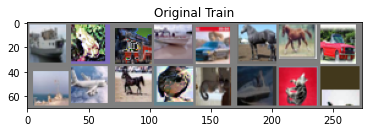

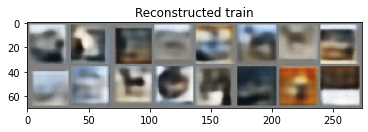

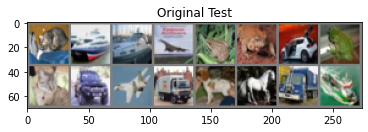

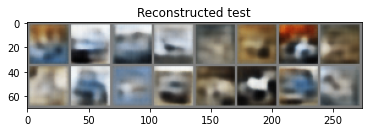

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 183.33820459716796 | KLD loss: 78.74867989257812


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 16 | Reconstruction test loss: 140.9643139038086 | KLD test loss: 76.52510789794921


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 181.75817391601564 | KLD loss: 77.90077680908203


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 17 | Reconstruction test loss: 142.42680324707032 | KLD test loss: 77.10099083251953


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 181.4633937841797 | KLD loss: 77.32994888183593


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 18 | Reconstruction test loss: 141.04648692626952 | KLD test loss: 76.6607669555664


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 179.90104014404298 | KLD loss: 76.53939079589844


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 19 | Reconstruction test loss: 139.6304390258789 | KLD test loss: 72.422972265625


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 179.86069678710936 | KLD loss: 76.09305735107422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 20 | Reconstruction test loss: 141.37095966796875 | KLD test loss: 71.75326949462891


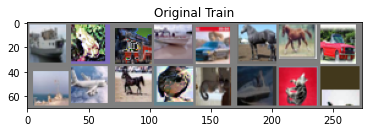

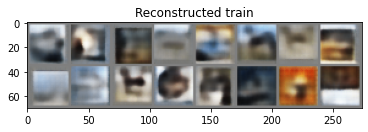

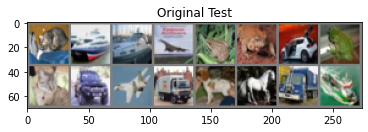

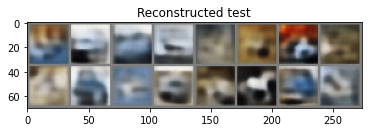

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 180.1727776196289 | KLD loss: 75.82785228515625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 21 | Reconstruction test loss: 139.95448859863282 | KLD test loss: 73.14474581298828


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 179.98173463134765 | KLD loss: 75.36745892578125


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 22 | Reconstruction test loss: 138.95659237060548 | KLD test loss: 73.07257764892579


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 178.9844703466797 | KLD loss: 74.86284207519532


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 23 | Reconstruction test loss: 140.76462021484375 | KLD test loss: 74.43251407470703


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 179.3129234350586 | KLD loss: 74.68400412353516


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 24 | Reconstruction test loss: 139.29433959960937 | KLD test loss: 73.83747098388672


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 177.3735483203125 | KLD loss: 75.03488839599609


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 25 | Reconstruction test loss: 136.45479146728516 | KLD test loss: 73.46383149414062


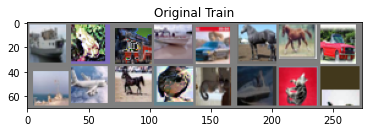

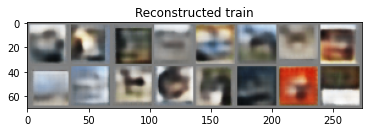

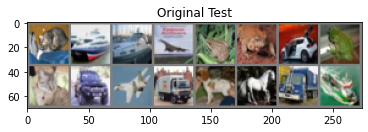

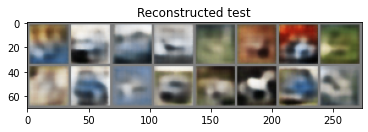

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 177.00231630371093 | KLD loss: 75.16518264648437


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 26 | Reconstruction test loss: 136.82301510009765 | KLD test loss: 73.39005510253907


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 175.9122281640625 | KLD loss: 74.92841797851563


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 27 | Reconstruction test loss: 137.2295867553711 | KLD test loss: 75.23149080810546


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 175.12327314697265 | KLD loss: 74.70658000732422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 28 | Reconstruction test loss: 134.28227868652343 | KLD test loss: 73.349965234375


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 174.7494030834961 | KLD loss: 75.46677290771484


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 29 | Reconstruction test loss: 137.26126911621094 | KLD test loss: 71.24572166748047


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 172.85083483398438 | KLD loss: 76.11819440185546


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 30 | Reconstruction test loss: 132.32923208007813 | KLD test loss: 75.07413757324218


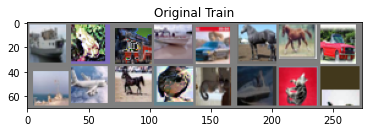

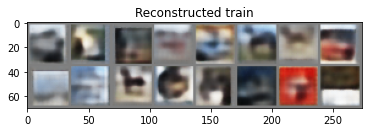

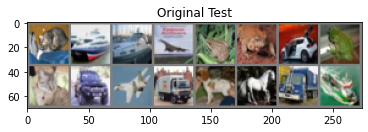

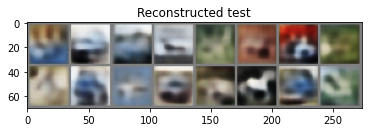

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 172.56159864257813 | KLD loss: 75.83115945800782


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 31 | Reconstruction test loss: 133.70976870117187 | KLD test loss: 74.50921701660157


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 171.76292205322267 | KLD loss: 75.35751476806641


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 32 | Reconstruction test loss: 131.6275660522461 | KLD test loss: 74.49427556152344


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 172.310382265625 | KLD loss: 75.21496560546875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 33 | Reconstruction test loss: 133.07959621582032 | KLD test loss: 72.72518214111328


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 172.3652544189453 | KLD loss: 74.98849758544922


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 34 | Reconstruction test loss: 132.04549678955078 | KLD test loss: 77.18505975341797


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 171.30953243164063 | KLD loss: 74.83629259033204


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 35 | Reconstruction test loss: 132.3776051269531 | KLD test loss: 72.78653841552735


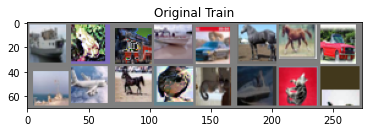

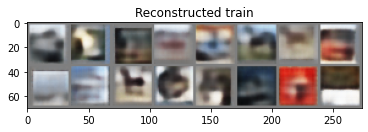

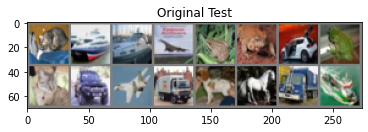

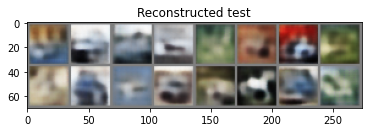

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 171.30245060546875 | KLD loss: 74.86843112548829


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 36 | Reconstruction test loss: 131.44725297851562 | KLD test loss: 73.31921303710938


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 171.31627989746093 | KLD loss: 74.7007496899414


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 37 | Reconstruction test loss: 132.86585205078126 | KLD test loss: 74.3431726196289


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 170.51688000732423 | KLD loss: 74.86116949951172


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 38 | Reconstruction test loss: 130.42131614990234 | KLD test loss: 73.07922192382813


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 169.0705412158203 | KLD loss: 75.11111593261718


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 39 | Reconstruction test loss: 130.36329299316407 | KLD test loss: 72.28622573242187


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 168.29694701904296 | KLD loss: 74.61375844238282


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 40 | Reconstruction test loss: 129.84682547607423 | KLD test loss: 73.88256204833985


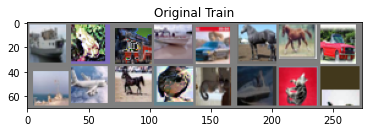

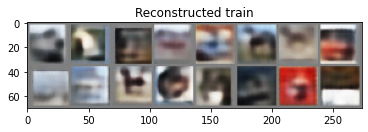

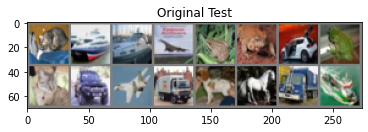

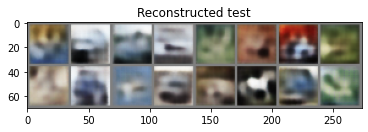

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 168.5236436767578 | KLD loss: 74.80938984130859


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 41 | Reconstruction test loss: 132.4756670654297 | KLD test loss: 73.7487986694336


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 167.64804355712891 | KLD loss: 75.92819822998047


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 42 | Reconstruction test loss: 130.77904725341796 | KLD test loss: 74.7740970336914


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 166.88150177001953 | KLD loss: 75.85321845458985


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 43 | Reconstruction test loss: 129.6149698852539 | KLD test loss: 74.75414138183594


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 166.51677966552734 | KLD loss: 75.61898474853515


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 44 | Reconstruction test loss: 128.43018052978516 | KLD test loss: 74.32212885742187


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 167.07604541503906 | KLD loss: 75.49397699462891


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 45 | Reconstruction test loss: 128.2478037475586 | KLD test loss: 75.30845144042969


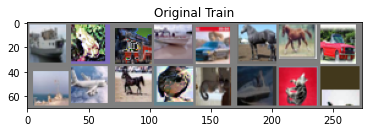

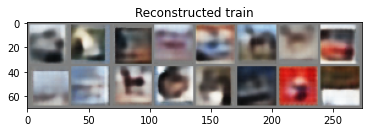

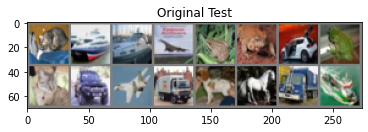

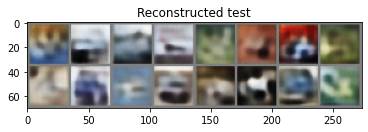

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 165.70671397216796 | KLD loss: 75.2605612133789


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 46 | Reconstruction test loss: 128.82533276367187 | KLD test loss: 75.91676452636719


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 165.73117273193358 | KLD loss: 75.0024227368164


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 47 | Reconstruction test loss: 129.7893541381836 | KLD test loss: 71.77348677978516


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 165.52618793945314 | KLD loss: 75.00392974365235


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 48 | Reconstruction test loss: 127.87978874511718 | KLD test loss: 74.25184010009765


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 164.95409217285157 | KLD loss: 74.85446831542968


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 49 | Reconstruction test loss: 127.8142486328125 | KLD test loss: 72.99261705322266


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 163.58179103759767 | KLD loss: 74.90547911865234


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 50 | Reconstruction test loss: 126.76356369628907 | KLD test loss: 73.04509033203125


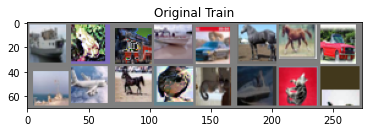

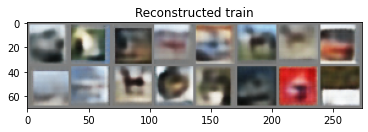

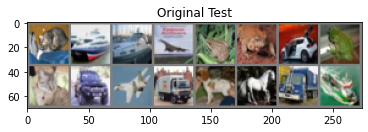

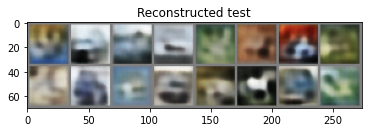

In [ ]:
train_loss, test_loss = train_vae(vae_model, vae_optim, device, mse_loss, trainloader, testloader, epochs=50, verbose_ep = 5)
torch.save(vae_model.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict_aug100")

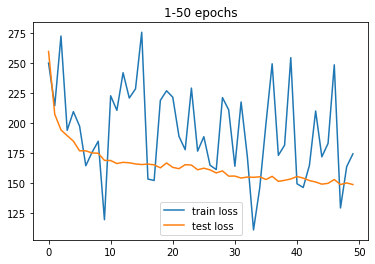

In [ ]:
plt.plot(train_loss, label="train loss")
plt.plot(test_loss, label="test loss")
plt.title("1-50 epochs")
plt.legend()
plt.show()

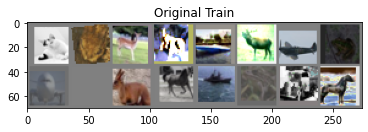

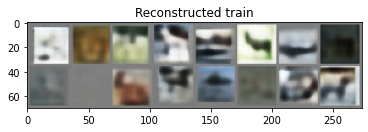

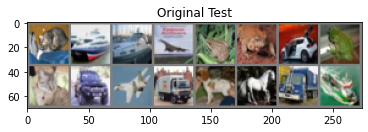

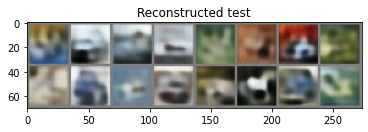

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 159.71825481689453 | KLD loss: 73.62260451171875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 123.28288807373048 | KLD test loss: 72.16079733886718


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 159.36807853515626 | KLD loss: 73.21725336914062


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 123.28086589355469 | KLD test loss: 72.26143970947265


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 159.35085709716796 | KLD loss: 73.02517824951173


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 123.3333666015625 | KLD test loss: 72.06109147949219


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 159.3091550683594 | KLD loss: 73.01319617919921


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 123.30359798583984 | KLD test loss: 71.07271180419922


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 158.83840468017578 | KLD loss: 73.02418596191406


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 122.66996634521485 | KLD test loss: 71.5665828125


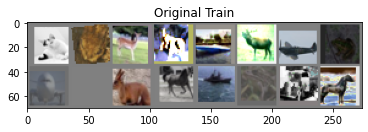

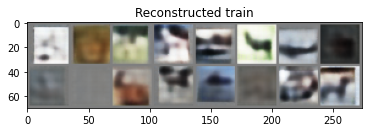

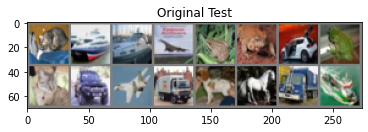

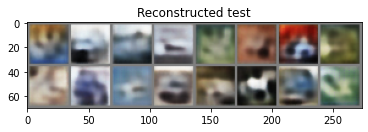

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 159.59764882080077 | KLD loss: 72.97145487548828


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 122.66376005859375 | KLD test loss: 72.22414256591797


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 159.34927902832032 | KLD loss: 72.98610372558593


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 122.82310743408203 | KLD test loss: 72.15761085205078


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 158.80577750976562 | KLD loss: 72.96554060791016


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 123.06288276367188 | KLD test loss: 71.12703845214844


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 158.93457665039062 | KLD loss: 72.98783629150391


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 122.9278712890625 | KLD test loss: 71.89348336181641


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 159.03631661376954 | KLD loss: 73.1594094140625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 122.50753060302735 | KLD test loss: 72.85645244140625


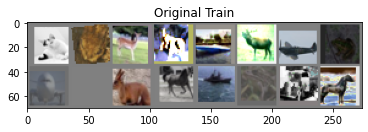

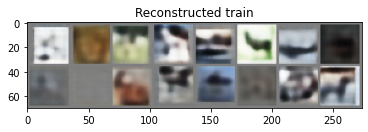

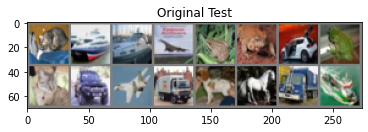

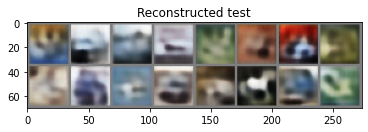

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 159.21370209716798 | KLD loss: 73.17631975585938


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 11 | Reconstruction test loss: 122.80867907714844 | KLD test loss: 72.02232038574219


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 158.36617717285156 | KLD loss: 73.22458294433594


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 12 | Reconstruction test loss: 122.26217458496093 | KLD test loss: 72.40592508544921


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 158.79612954345703 | KLD loss: 73.44008769775391


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 13 | Reconstruction test loss: 122.78729812011719 | KLD test loss: 71.9587681640625


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 158.57354340820314 | KLD loss: 73.54724984375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 14 | Reconstruction test loss: 122.4410424194336 | KLD test loss: 72.72651658935547


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 158.01811814453126 | KLD loss: 73.67832130615234


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 15 | Reconstruction test loss: 122.44448557128906 | KLD test loss: 72.68597487792968


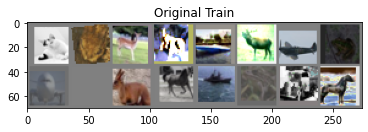

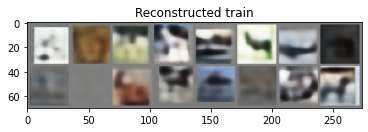

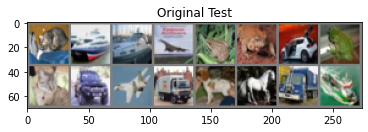

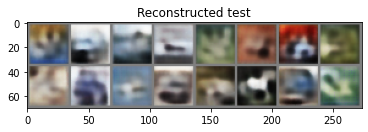

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 158.8305859741211 | KLD loss: 73.85841030273437


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 16 | Reconstruction test loss: 122.1509776977539 | KLD test loss: 73.20802972412109


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 158.2264793310547 | KLD loss: 73.95596102539062


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 17 | Reconstruction test loss: 121.8986886352539 | KLD test loss: 72.88158188476562


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 158.56793125976563 | KLD loss: 73.93321625732422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 18 | Reconstruction test loss: 121.68237322998047 | KLD test loss: 72.45371856689454


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 157.47508166748048 | KLD loss: 74.04690122802734


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 19 | Reconstruction test loss: 122.40232745361328 | KLD test loss: 72.42129044189453


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 157.28527385009767 | KLD loss: 73.94144399902343


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 20 | Reconstruction test loss: 122.89483017578125 | KLD test loss: 72.34231506347656


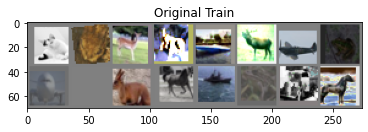

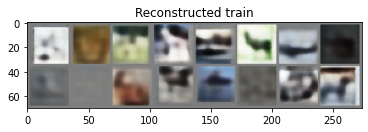

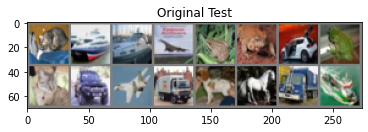

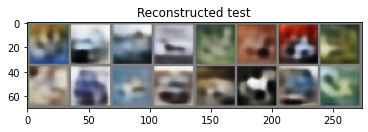

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 158.1667568774414 | KLD loss: 74.03182575439453


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 21 | Reconstruction test loss: 121.91360451660157 | KLD test loss: 72.4717682006836


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 156.9990492163086 | KLD loss: 73.94015287597657


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 22 | Reconstruction test loss: 121.88664129638671 | KLD test loss: 72.54340850830079


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 157.14550157958985 | KLD loss: 73.95422080322265


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 23 | Reconstruction test loss: 122.23407930908203 | KLD test loss: 71.89969880371093


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 157.4556882788086 | KLD loss: 74.04660091796875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 24 | Reconstruction test loss: 121.31430435791016 | KLD test loss: 72.81428967285156


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 157.0746995288086 | KLD loss: 74.11928705810547


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 25 | Reconstruction test loss: 121.5799001953125 | KLD test loss: 72.61175126953125


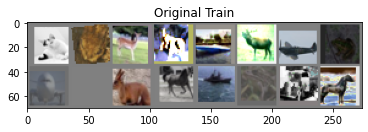

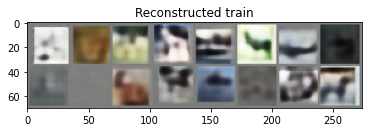

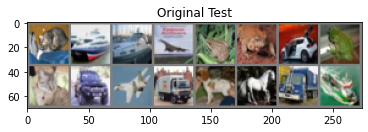

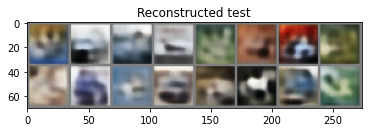

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 157.377308515625 | KLD loss: 74.25311158935547


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 26 | Reconstruction test loss: 121.94645078125 | KLD test loss: 72.07174925537109


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 157.27313613037109 | KLD loss: 74.73459616455078


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 27 | Reconstruction test loss: 121.37495399169921 | KLD test loss: 72.93158146972657


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 157.35091459228516 | KLD loss: 75.03164009277344


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 28 | Reconstruction test loss: 120.98100535888672 | KLD test loss: 72.9638130493164


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 156.22215635498046 | KLD loss: 75.03862824951172


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 29 | Reconstruction test loss: 121.59305617675781 | KLD test loss: 73.48198917236328


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 155.92777486572265 | KLD loss: 75.06705084472657


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 30 | Reconstruction test loss: 120.86285240478516 | KLD test loss: 73.2919626953125


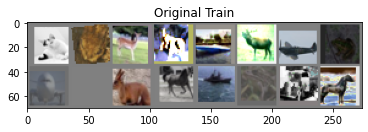

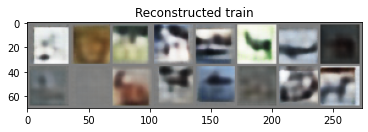

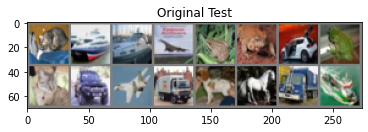

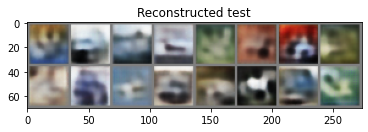

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 156.27161315917968 | KLD loss: 75.21213165771485


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 31 | Reconstruction test loss: 120.76343851318359 | KLD test loss: 73.34733143310547


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 156.1739651586914 | KLD loss: 75.14300179443359


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 32 | Reconstruction test loss: 120.62617795410156 | KLD test loss: 73.1463615600586


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 156.05231609863282 | KLD loss: 75.20680312988281


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 33 | Reconstruction test loss: 120.11432401123047 | KLD test loss: 74.12201812744141


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 155.23446939941405 | KLD loss: 75.20044262451172


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 34 | Reconstruction test loss: 121.46163931884766 | KLD test loss: 73.84409909667968


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 155.24084682617186 | KLD loss: 75.16784109130859


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 35 | Reconstruction test loss: 120.06309549560547 | KLD test loss: 73.53887868652343


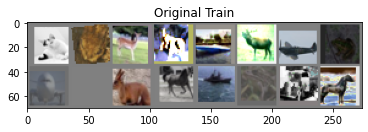

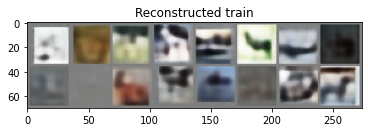

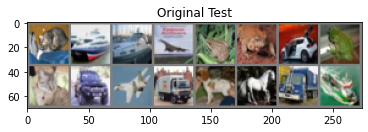

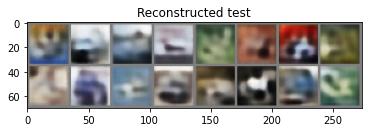

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 156.10332291992188 | KLD loss: 75.14978286621094


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 36 | Reconstruction test loss: 120.80343149414063 | KLD test loss: 73.43155125732422


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 155.89094138183594 | KLD loss: 75.27013357421875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 37 | Reconstruction test loss: 120.07400887451172 | KLD test loss: 73.54044993896484


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 155.87390594726563 | KLD loss: 75.36237201660157


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 38 | Reconstruction test loss: 120.159251171875 | KLD test loss: 73.98707811279297


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 155.56215703125 | KLD loss: 75.60625825439453


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 39 | Reconstruction test loss: 119.3466405883789 | KLD test loss: 74.4708721069336


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 154.26966977294921 | KLD loss: 76.01155235107422


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 40 | Reconstruction test loss: 119.010343359375 | KLD test loss: 74.88208891601562


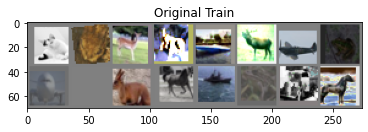

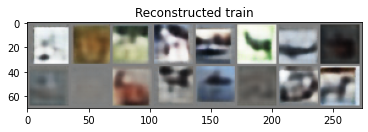

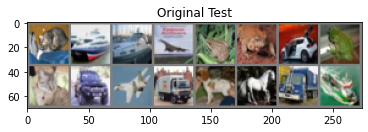

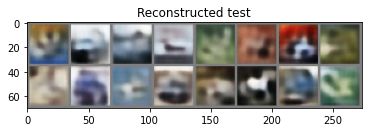

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 153.91349663330078 | KLD loss: 76.61378907714844


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 41 | Reconstruction test loss: 119.45469719238281 | KLD test loss: 74.56000118408203


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 154.0853271142578 | KLD loss: 77.15856111572266


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 42 | Reconstruction test loss: 118.7515337524414 | KLD test loss: 75.13874685058593


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 153.13541879394532 | KLD loss: 77.48860122558594


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 43 | Reconstruction test loss: 118.41580924072265 | KLD test loss: 74.92686125488281


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 153.76661120117188 | KLD loss: 78.00230319091797


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 44 | Reconstruction test loss: 118.41801982421875 | KLD test loss: 75.94316033935547


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 153.2585031225586 | KLD loss: 78.37693893554687


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 45 | Reconstruction test loss: 117.8602918701172 | KLD test loss: 77.29965571289063


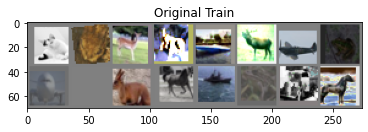

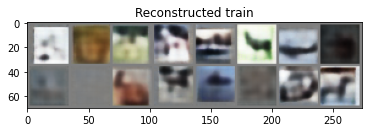

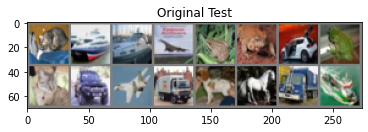

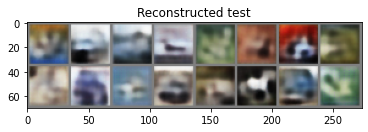

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 152.24465526123046 | KLD loss: 78.67644086425781


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 46 | Reconstruction test loss: 117.31865146484375 | KLD test loss: 76.97795142822265


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 152.7831608984375 | KLD loss: 79.23639165527344


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 47 | Reconstruction test loss: 117.63429211425782 | KLD test loss: 77.50840139160157


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 151.83961137695312 | KLD loss: 79.72237912109375


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 48 | Reconstruction test loss: 116.86588541259766 | KLD test loss: 77.14417667236329


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 151.1158891821289 | KLD loss: 80.17265166992188


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 49 | Reconstruction test loss: 116.12037856445312 | KLD test loss: 78.91572479248048


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 149.99251157470704 | KLD loss: 80.67290528564453


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 50 | Reconstruction test loss: 116.1092228881836 | KLD test loss: 79.31998365478516


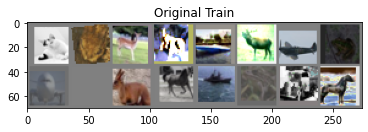

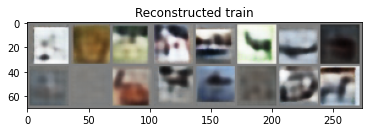

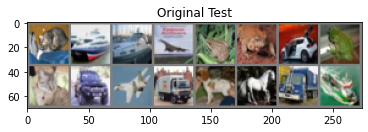

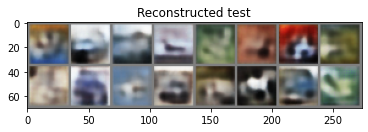

In [ ]:
vae_optim = Adam(vae_model.parameters(), lr=1e-4)
train_loss, test_loss = train_vae(vae_model, vae_optim, device, mse_loss, trainloader, testloader, epochs=50, verbose_ep = 5)
torch.save(vae_model.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict_aug100")

## LogCosh

In [ ]:
vae_logcosh_model = VAE()
vae_optim = Adam(vae_logcosh_model.parameters())
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
trainloader, testloader = create_loaders(trainset, testset)
print(device)

cuda


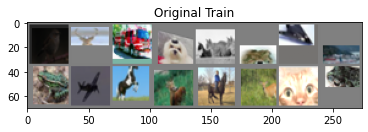

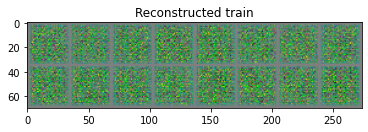

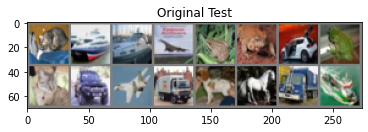

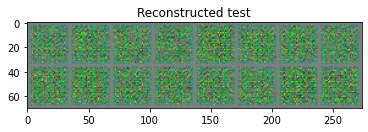

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 696.0171588183593 | KLD loss: 105.32147707172393


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 571.5240172851562 | KLD test loss: 115.58344002685547


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 566.3244046191406 | KLD loss: 118.08200010498047


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 509.0169241210937 | KLD test loss: 106.64549848632812


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 526.1186910546875 | KLD loss: 121.68898673583985


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 470.22178481445314 | KLD test loss: 129.06318651123047


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 500.8102090625 | KLD loss: 121.93531899902344


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 462.68687802734377 | KLD test loss: 113.0652025390625


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 487.8419166308594 | KLD loss: 119.05931626708984


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 453.743949609375 | KLD test loss: 116.35333959960937


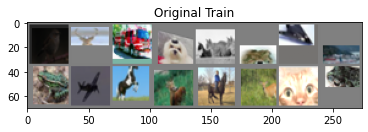

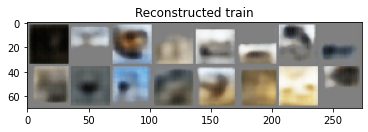

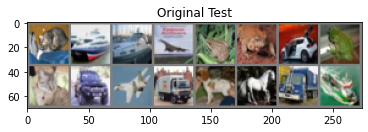

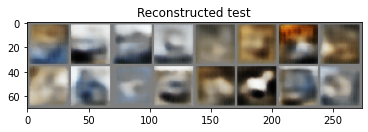

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 482.17036112304686 | KLD loss: 116.0653376196289


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 451.1406686523438 | KLD test loss: 108.04864188232422


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 475.09203796875 | KLD loss: 112.85077385986328


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 441.9039871582031 | KLD test loss: 106.69459871826172


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 470.7427657324219 | KLD loss: 110.14044190673827


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 433.61950200195315 | KLD test loss: 105.87788970947265


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 465.01239755859376 | KLD loss: 108.474717421875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 443.24574887695314 | KLD test loss: 104.70524244384765


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 462.80637014648437 | KLD loss: 106.41231103759766


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 431.1959501464844 | KLD test loss: 105.00550938720703


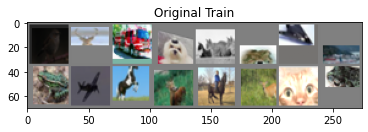

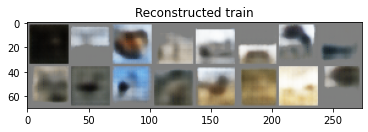

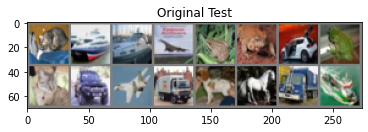

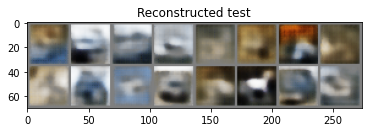

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 456.9965650390625 | KLD loss: 106.05511991455079


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 11 | Reconstruction test loss: 427.02982568359374 | KLD test loss: 101.72255965576171


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 454.8950044335937 | KLD loss: 104.9069130883789


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 12 | Reconstruction test loss: 425.8373435058594 | KLD test loss: 100.1217155883789


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 453.3218207519531 | KLD loss: 103.93540206542968


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 13 | Reconstruction test loss: 426.79360146484373 | KLD test loss: 103.1439341796875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 448.5513330957031 | KLD loss: 103.90988541503906


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 14 | Reconstruction test loss: 423.6468860839844 | KLD test loss: 100.85955985107422


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 444.62351067382815 | KLD loss: 103.1677912475586


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 15 | Reconstruction test loss: 422.0152599121094 | KLD test loss: 101.69031750488281


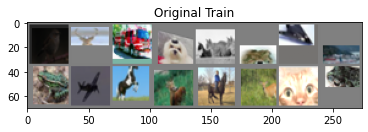

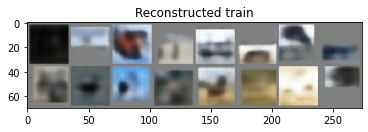

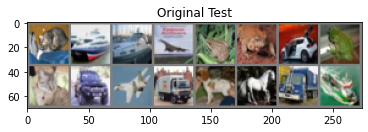

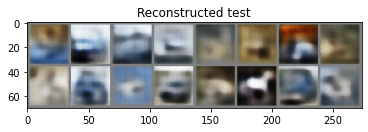

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 442.3296028417969 | KLD loss: 103.83821177734374


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 16 | Reconstruction test loss: 411.78605126953124 | KLD test loss: 105.2238977783203


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 440.03446056640627 | KLD loss: 104.17715201171875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 17 | Reconstruction test loss: 409.1211178222656 | KLD test loss: 104.79829367675781


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 436.57591591796876 | KLD loss: 104.40010264404297


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 18 | Reconstruction test loss: 402.4425314941406 | KLD test loss: 106.73802110595703


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 434.17795345703126 | KLD loss: 105.6577090258789


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 19 | Reconstruction test loss: 406.94998540039063 | KLD test loss: 104.20135197753906


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 428.8302760888672 | KLD loss: 107.15832810058593


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 20 | Reconstruction test loss: 396.8698408691406 | KLD test loss: 107.54910217285156


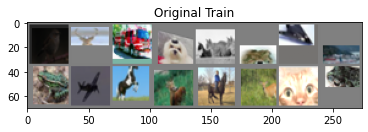

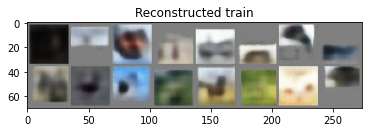

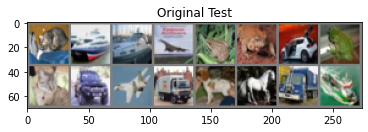

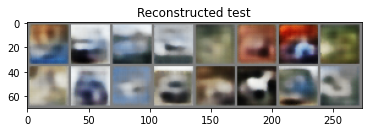

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 425.1523931542969 | KLD loss: 109.77672180419921


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 21 | Reconstruction test loss: 393.5285077148437 | KLD test loss: 108.64529047851562


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 421.0983695556641 | KLD loss: 109.60954330322265


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 22 | Reconstruction test loss: 389.02685532226565 | KLD test loss: 105.78922163085937


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 420.05452337890625 | KLD loss: 109.05242268310546


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 23 | Reconstruction test loss: 390.0447577636719 | KLD test loss: 107.4498614868164


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 418.23962357421874 | KLD loss: 108.66123362304687


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 24 | Reconstruction test loss: 387.1440587890625 | KLD test loss: 107.04834145507813


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 416.3742235546875 | KLD loss: 109.28025592041016


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 25 | Reconstruction test loss: 388.7753287109375 | KLD test loss: 109.08201138916016


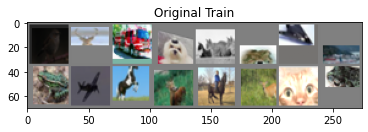

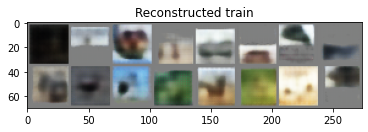

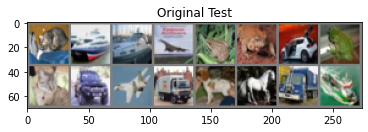

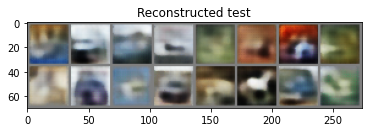

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 414.30381657714844 | KLD loss: 109.58024877929688


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 26 | Reconstruction test loss: 392.20594790039064 | KLD test loss: 105.62394681396485


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 412.2471991015625 | KLD loss: 109.33276040771484


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 27 | Reconstruction test loss: 384.60517104492186 | KLD test loss: 106.86775103759766


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 409.05280166992185 | KLD loss: 109.25533409667969


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 28 | Reconstruction test loss: 391.29199770507813 | KLD test loss: 105.64845627441406


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 406.44868883789064 | KLD loss: 109.49646672119141


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 29 | Reconstruction test loss: 395.2557099609375 | KLD test loss: 104.46015404052734


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 406.0094382421875 | KLD loss: 109.54924741699219


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 30 | Reconstruction test loss: 377.47397119140624 | KLD test loss: 109.65725023193359


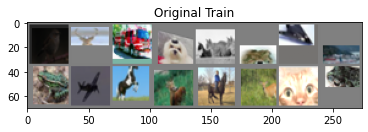

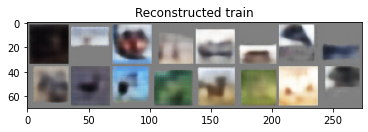

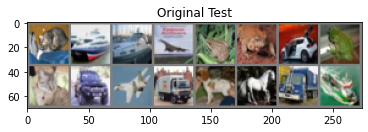

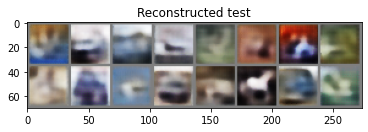

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 404.1762794287109 | KLD loss: 109.9587732055664


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 31 | Reconstruction test loss: 375.18316342773437 | KLD test loss: 108.31065982666016


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 402.5249362011719 | KLD loss: 109.76862241455078


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 32 | Reconstruction test loss: 378.5308999511719 | KLD test loss: 108.21500294189453


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 399.94861400390624 | KLD loss: 110.50304983398438


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 33 | Reconstruction test loss: 374.77085693359373 | KLD test loss: 107.54119870605469


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 398.0149346484375 | KLD loss: 111.11861460205078


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 34 | Reconstruction test loss: 370.01284057617187 | KLD test loss: 110.32081478271485


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 396.7397409472656 | KLD loss: 110.94493830322266


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 35 | Reconstruction test loss: 374.48091259765624 | KLD test loss: 108.7083719116211


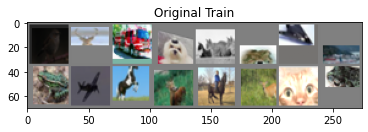

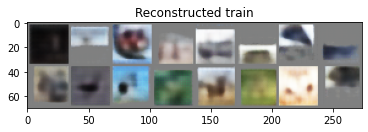

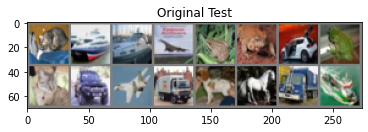

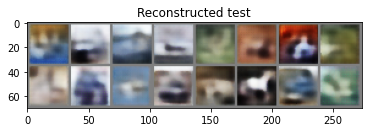

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 395.12331912109374 | KLD loss: 110.8040454321289


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 36 | Reconstruction test loss: 368.15837573242186 | KLD test loss: 110.55824495849609


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 393.19828050292966 | KLD loss: 111.29516161621093


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 37 | Reconstruction test loss: 366.7199697265625 | KLD test loss: 109.11842967529297


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 393.631066640625 | KLD loss: 111.89613381103516


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 38 | Reconstruction test loss: 378.5703873046875 | KLD test loss: 104.94285554199219


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 391.2790624658203 | KLD loss: 111.44387798339844


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 39 | Reconstruction test loss: 367.1877896484375 | KLD test loss: 104.93687718505859


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 389.9820327685547 | KLD loss: 110.93663079345703


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 40 | Reconstruction test loss: 362.0834948730469 | KLD test loss: 107.80115415039063


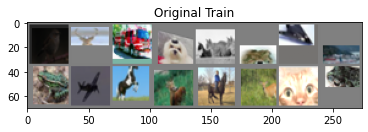

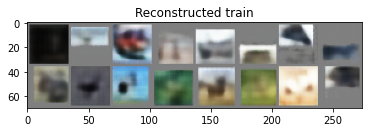

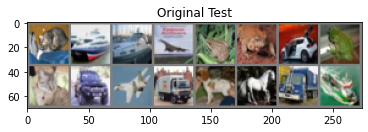

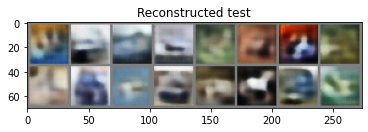

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 390.2524805224609 | KLD loss: 110.66502982910156


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 41 | Reconstruction test loss: 364.8815311035156 | KLD test loss: 110.08153035888672


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 388.9367612109375 | KLD loss: 110.16417704589844


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 42 | Reconstruction test loss: 361.67861884765625 | KLD test loss: 108.60899926757813


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 388.5481781201172 | KLD loss: 110.29801362548828


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 43 | Reconstruction test loss: 366.1562878417969 | KLD test loss: 106.2565296875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 387.26184337402344 | KLD loss: 110.9997879736328


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 44 | Reconstruction test loss: 363.27306958007813 | KLD test loss: 108.40090216064453


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 386.72069890625 | KLD loss: 111.13408220458984


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 45 | Reconstruction test loss: 355.993774609375 | KLD test loss: 107.60207877197266


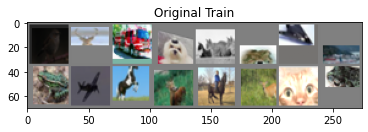

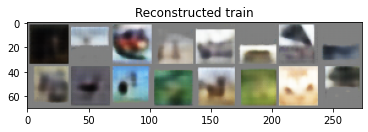

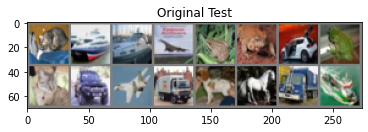

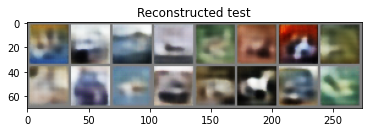

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 384.4538363720703 | KLD loss: 111.60444373291016


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 46 | Reconstruction test loss: 366.76214677734373 | KLD test loss: 110.00166223144531


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 384.24465325683593 | KLD loss: 111.98099219970703


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 47 | Reconstruction test loss: 359.0059794921875 | KLD test loss: 108.298311328125


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 382.55154177246095 | KLD loss: 111.6643062524414


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 48 | Reconstruction test loss: 353.733168359375 | KLD test loss: 108.99598992919923


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 382.3985413330078 | KLD loss: 111.46173417236328


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 49 | Reconstruction test loss: 353.5670047363281 | KLD test loss: 108.38158939208985


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 382.7948944189453 | KLD loss: 111.33283764892577


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 50 | Reconstruction test loss: 358.3088085449219 | KLD test loss: 109.91022194824218


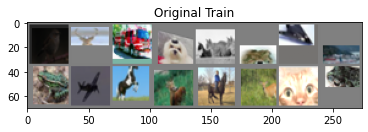

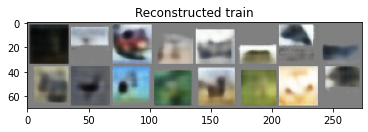

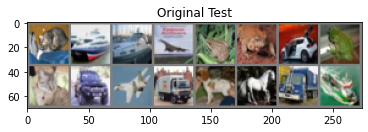

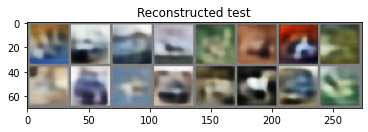

In [ ]:
train_loss, test_loss = train_vae(vae_logcosh_model, vae_optim, device, logcosh_loss, trainloader, testloader, epochs=50, verbose_ep = 5, alpha = 25.)

In [ ]:
torch.save(vae_logcosh_model.state_dict(), "vae_logcosh_state_dict_aug50")

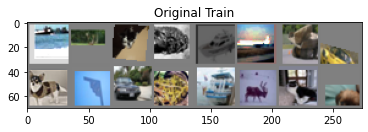

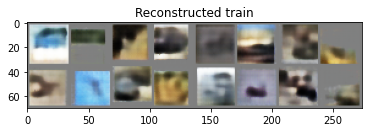

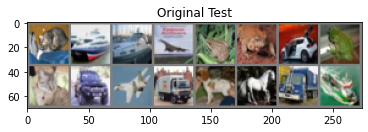

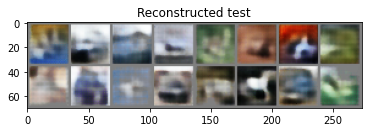

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 374.1273169482422 | KLD loss: 109.54325639648438


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 1 | Reconstruction test loss: 348.5027802734375 | KLD test loss: 106.53301805419922


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 374.24313801757813 | KLD loss: 108.77375666015625


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 2 | Reconstruction test loss: 349.4251796875 | KLD test loss: 106.19035772705078


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 371.7180395263672 | KLD loss: 108.46768522216797


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 3 | Reconstruction test loss: 347.06188510742186 | KLD test loss: 106.25649676513672


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 371.86066537597657 | KLD loss: 108.34247463623046


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 4 | Reconstruction test loss: 347.2270677734375 | KLD test loss: 107.15093863525391


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 372.63139465820313 | KLD loss: 108.42018801513672


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 5 | Reconstruction test loss: 347.2965560058594 | KLD test loss: 106.68233803710937


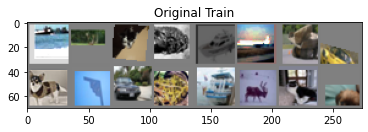

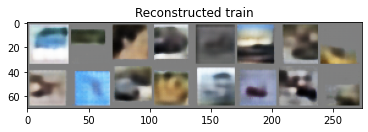

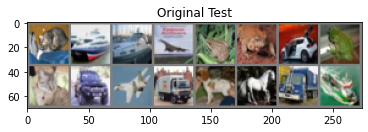

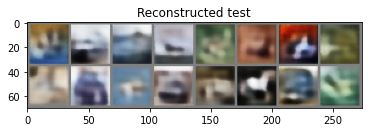

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 372.0936337011719 | KLD loss: 108.26968669921875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 6 | Reconstruction test loss: 346.65590625 | KLD test loss: 106.53964738769531


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 371.4133916357422 | KLD loss: 108.30638385253906


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 7 | Reconstruction test loss: 347.84640786132815 | KLD test loss: 106.47291428222657


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 371.24718045410157 | KLD loss: 108.3673634399414


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 8 | Reconstruction test loss: 345.9868087402344 | KLD test loss: 107.4071095703125


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 371.1395515429688 | KLD loss: 108.20546783935546


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 9 | Reconstruction test loss: 345.65732734375 | KLD test loss: 106.41158728027344


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 369.4757015673828 | KLD loss: 108.30541873046874


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 10 | Reconstruction test loss: 346.1412348632812 | KLD test loss: 107.85257966308593


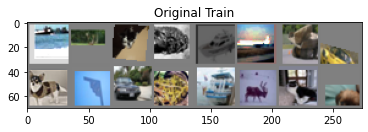

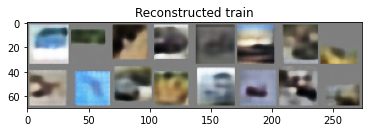

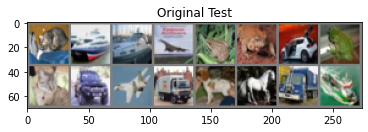

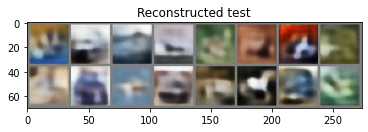

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 370.4831136474609 | KLD loss: 108.52306498779296


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 11 | Reconstruction test loss: 344.5765294921875 | KLD test loss: 107.68863205566406


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 371.35257708984375 | KLD loss: 108.49293008789063


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 12 | Reconstruction test loss: 343.5146000976562 | KLD test loss: 107.64240185546875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 369.27859848144533 | KLD loss: 108.61142799804688


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 13 | Reconstruction test loss: 346.9598586425781 | KLD test loss: 107.3487017944336


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 368.7224684277344 | KLD loss: 108.69914291748047


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 14 | Reconstruction test loss: 345.47991982421877 | KLD test loss: 107.6588379272461


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 369.37886844238284 | KLD loss: 108.86415697021485


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 15 | Reconstruction test loss: 344.7873522949219 | KLD test loss: 108.13795634765626


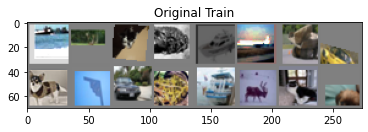

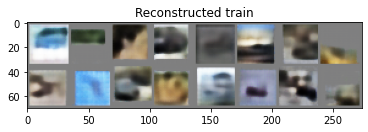

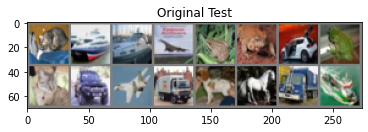

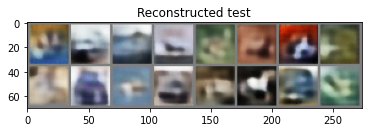

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 369.8149967480469 | KLD loss: 108.80461874267579


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 16 | Reconstruction test loss: 345.81320478515624 | KLD test loss: 108.86299134521484


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 368.12699841796876 | KLD loss: 108.75050678710937


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 17 | Reconstruction test loss: 343.593848828125 | KLD test loss: 107.31459426269531


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 368.8053393798828 | KLD loss: 108.64194225830079


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 18 | Reconstruction test loss: 345.49951958007813 | KLD test loss: 107.31494921875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 369.2836085888672 | KLD loss: 108.58447428466796


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 19 | Reconstruction test loss: 344.5503548828125 | KLD test loss: 107.62373685302734


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 368.4875660498047 | KLD loss: 108.68631032226563


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 20 | Reconstruction test loss: 345.63471552734376 | KLD test loss: 107.56665454101562


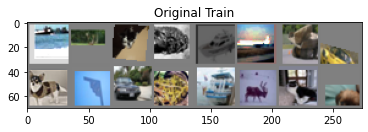

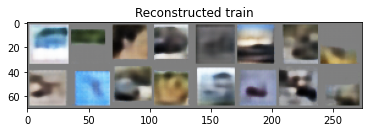

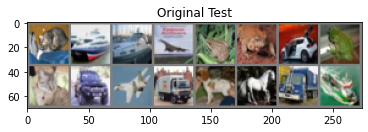

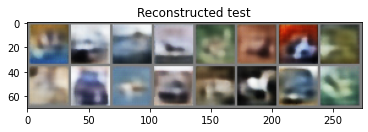

  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 368.1428898779297 | KLD loss: 108.53447435546875


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 21 | Reconstruction test loss: 343.183860546875 | KLD test loss: 107.55829482421875


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 368.0058235644531 | KLD loss: 108.50531629882812


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 22 | Reconstruction test loss: 343.5739064453125 | KLD test loss: 106.72792416992188


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 367.58466391601564 | KLD loss: 108.57614215087891


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 23 | Reconstruction test loss: 344.4904470214844 | KLD test loss: 106.96822475585938


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 368.46364064453127 | KLD loss: 108.4479607446289


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 24 | Reconstruction test loss: 343.47501025390625 | KLD test loss: 108.18025809326171


  0%|          | 0/3125 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 368.6920326464844 | KLD loss: 108.47003803466797


  0%|          | 0/625 [00:00<?, ?it/s]

Epoch 25 | Reconstruction test loss: 343.49533129882815 | KLD test loss: 107.6170675415039


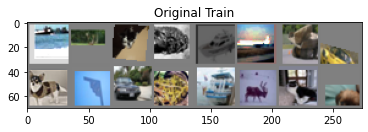

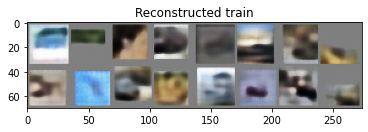

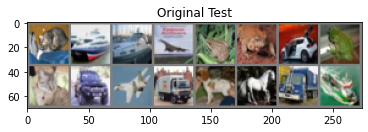

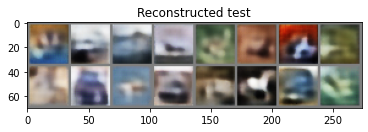

In [ ]:
vae_logcosh_model.load_state_dict(torch.load("/content/vae_logcosh_state_dict_aug50"))
vae_optim = Adam(vae_logcosh_model.parameters(), lr=1e-4)
train_loss, test_loss = train_vae(vae_logcosh_model, vae_optim, device, logcosh_loss, trainloader, testloader, epochs=25, verbose_ep = 5, alpha = 25.)
# torch.save(vae_logcosh_model.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_logcosh_state_dict_aug50")
torch.save(vae_logcosh_model.state_dict(), "vae_logcosh_state_dict_aug75")


# Compare

Просто сравню все обученные модели на 2 используемых loss функциях.

In [8]:
def calc_average_rec_loss(loss_func: tp.Callable, testloader: DataLoader, model: nn.Module, device: tp.Any, **loss_kwargs):
    model.eval()

    dataiter = iter(testloader)
    test_img, _ = next(dataiter)

    imshow(torchvision.utils.make_grid(test_img), "Original Test")

    test_rec_img, _ = model(test_img.to(device))
    imshow(torchvision.utils.make_grid(test_rec_img.cpu()), "Reconstructed test")

    batch_size = testloader.batch_size
    with torch.no_grad():
        total_batches = 0
        rec_loss_avg = 0
        for batch, _ in tqdm(testloader):
            total_batches += 1
            img = batch.to(device)
            rec_img, _ = model(img)
            rec_loss = loss_func(rec_img, img, **loss_kwargs) / batch_size
            rec_loss_avg += rec_loss.item()
    
    print(f"AVG Loss on test set: {rec_loss_avg / total_batches}")

## MSE

In [16]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 16

trainset, testset, classes = load_data('./data', transform, transform)
_, testloader = create_loaders(trainset, testset)

Files already downloaded and verified
Files already downloaded and verified


### Small VAE

In [12]:
small_vae = VAE(img_size=32, downsamplings=3, latent_size=64, linear_hidden_size=128, down_channels=4, up_channels=4)
small_vae.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/smaller_vae_state_dict50",
        map_location=device,
    ),
)

<All keys matched successfully>

Small VAE model, mse


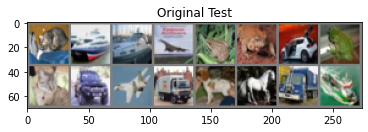

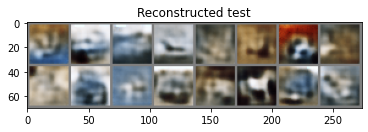

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 108.95579578857422
Small VAE model, logcosh


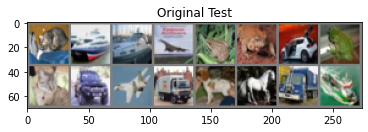

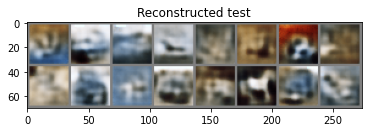

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 346.63029453125


In [18]:
print("Small VAE model, mse")
calc_average_rec_loss(mse_loss, testloader, small_vae, device)

print("Small VAE model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, small_vae, device, alpha = 25.)

Small VAE model, mse


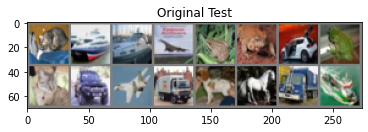

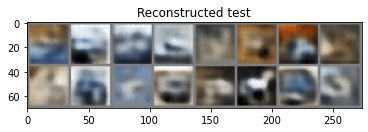

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 154.52500037841796
Small VAE model, logcosh


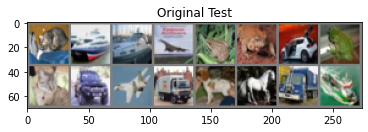

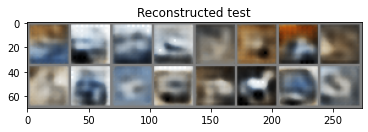

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 430.0144853515625


In [44]:
small_vae = VAE(img_size=32, downsamplings=3, latent_size=64, linear_hidden_size=128, down_channels=4, up_channels=4)
small_vae.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/small_vae_state_dict_aug50",
        map_location=device,
    ),
)

print("Small VAE model, mse")
calc_average_rec_loss(mse_loss, testloader, small_vae, device)

print("Small VAE model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, small_vae, device, alpha = 25.)

### VAE, 50 epochs

In [19]:
vae = VAE()
vae.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict50",
        map_location=device,
    ),
)

<All keys matched successfully>

VAE50 model, mse


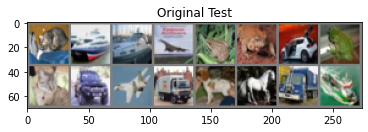

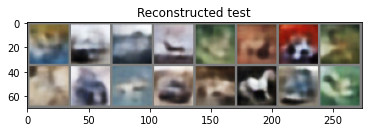

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 116.39689733886719
VAE50 model, logcosh


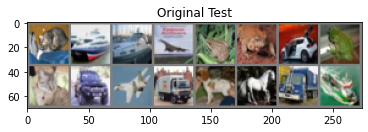

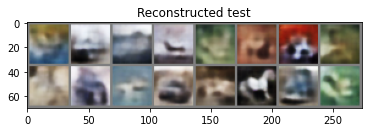

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 355.0266484863281


In [21]:
print("VAE50 model, mse")
calc_average_rec_loss(mse_loss, testloader, vae, device)

print("VAE50 model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, vae, device, alpha = 25.)

### VAE, 100 epochs

In [22]:
vae = VAE()
vae.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict100",
        map_location=device,
    ),
)

<All keys matched successfully>

VAE100 model, mse


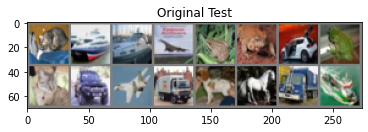

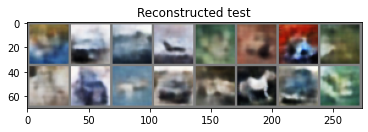

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 120.09319356689453
VAE100 model, logcosh


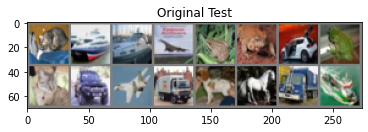

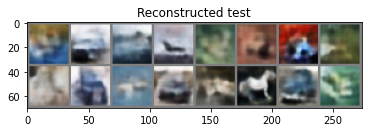

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 360.7189411621094


In [23]:
print("VAE100 model, mse")
calc_average_rec_loss(mse_loss, testloader, vae, device)

print("VAE100 model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, vae, device, alpha = 25.)

### VAE + aug, 100 epochs

In [24]:
vae = VAE()
vae.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_state_dict_aug100",
        map_location=device,
    ),
)

<All keys matched successfully>

VAE100 model, mse


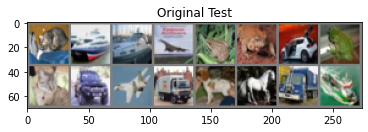

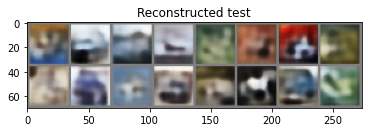

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 116.08175137939453
VAE100 model, logcosh


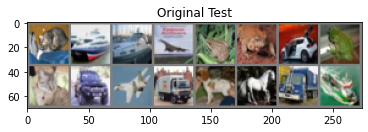

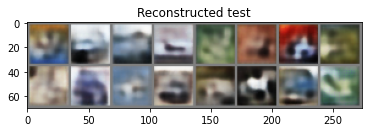

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 355.57336416015625


In [25]:
print("VAE100 model, mse")
calc_average_rec_loss(mse_loss, testloader, vae, device)

print("VAE100 model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, vae, device, alpha = 25.)

## Log + Cosh

### Small VAE, 50 epochs

Small VAE model, mse


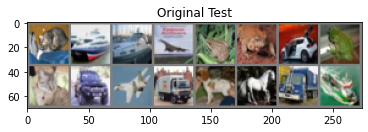

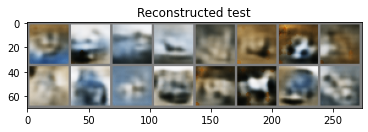

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 110.18316779785157
Small VAE model, logcosh


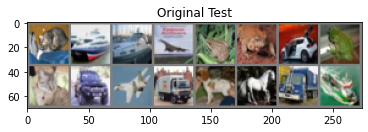

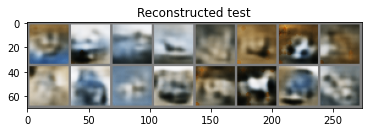

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 343.11231411132815


In [45]:
small_vae = VAE(img_size=32, downsamplings=3, latent_size=64, linear_hidden_size=128, down_channels=4, up_channels=4)
small_vae.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/small_logcosh_vae_state_dict50",
        map_location=device,
    ),
)

print("Small VAE model, mse")
calc_average_rec_loss(mse_loss, testloader, small_vae, device)

print("Small VAE model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, small_vae, device, alpha = 25.)

### VAE, 50 epochs

In [26]:
vaelg = VAE()
vaelg.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/logcosh_vae_state_dict50",
        map_location=device,
    ),
)

<All keys matched successfully>

VAE100 model, mse


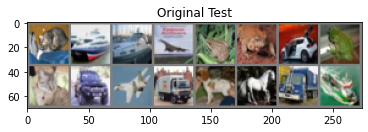

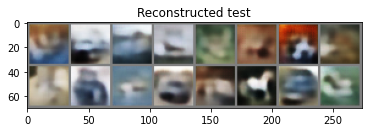

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 120.18925155029297
VAE100 model, logcosh


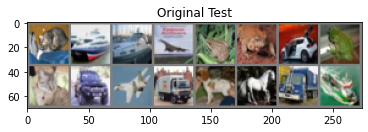

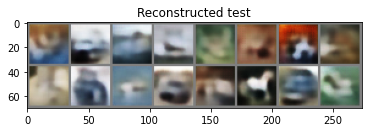

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 354.02211767578126


In [27]:
print("VAE50 model, mse")
calc_average_rec_loss(mse_loss, testloader, vaelg, device)

print("VAE50 model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, vaelg, device, alpha = 25.)

### VAE + aug, 50 epochs

In [28]:
vaelg = VAE()
vaelg.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_logcosh_state_dict_aug50",
        map_location=device,
    ),
)

<All keys matched successfully>

VAE100 model, mse


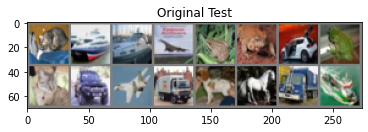

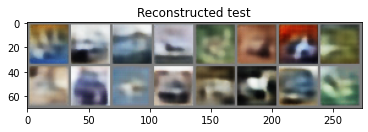

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 120.60349172363281
VAE100 model, logcosh


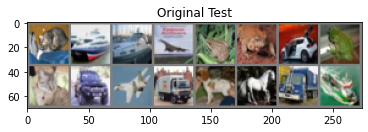

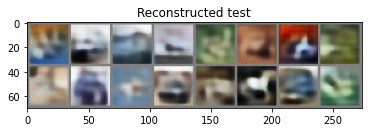

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 358.31917041015623


In [29]:
print("VAE50 model, mse")
calc_average_rec_loss(mse_loss, testloader, vaelg, device)

print("VAE50 model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, vaelg, device, alpha = 25.)

### VAE + aug, 75 epochs

In [30]:
vaelg = VAE()
vaelg.load_state_dict(
    torch.load(
        "/content/drive/MyDrive/Colab_Notebooks/interview_ass/MIL/vae_logcosh_state_dict_aug50",
        map_location=device,
    ),
)

<All keys matched successfully>

VAE75 model, mse


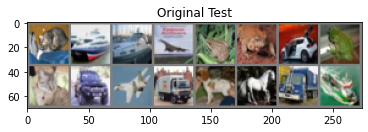

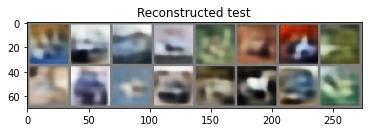

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 120.60659057617187
VAE75 model, logcosh


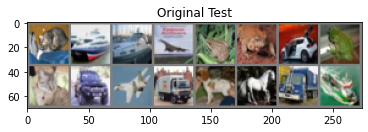

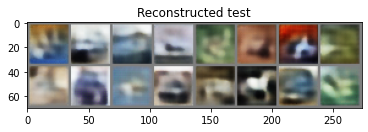

  0%|          | 0/625 [00:00<?, ?it/s]

AVG Loss on test set: 358.40539301757815


In [31]:
print("VAE75 model, mse")
calc_average_rec_loss(mse_loss, testloader, vaelg, device)

print("VAE75 model, logcosh")
calc_average_rec_loss(logcosh_loss, testloader, vaelg, device, alpha = 25.)

# Мысли

## Loss

Собсвенно начал я с того, что посмотрел насколько вообще MSE может быть большим для нормированных изображений, чтоб понимать (не только визуально) что VAE работает.
Начал с предположения (неверного), что значение пикселя (нормированного) $ η, λ\sim U(-1, 1)$, посчиталось $𝐄((η - λ)^2) = \frac{2}{3}$. Тогда за верхнюю границу можно взять $32 \cdot 32 \cdot 3 \cdot \frac{2}{3} = 2048$.

Конечно проще было просто сделать bootstrap выборки и посмотреть.

In [3]:
import numpy as np

In [11]:
mse = []

for _ in range(10000):
    ind1 = 1
    ind2 = 1
    while ind1 == ind2:
        ind1 = np.random.randint(0, len(testset))
        ind2 = np.random.randint(0, len(testset))
    img1, _ = testset[ind1]
    img2, _ = testset[ind2]
    mse.append(
        mse_loss(img1, img2).item()
    )


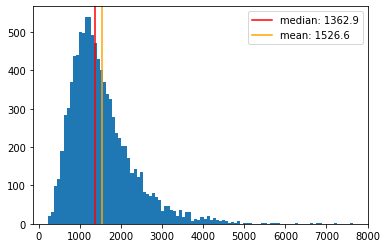

In [20]:
plt.hist(mse, bins=100)
med = np.median(mse)
mean = np.mean(mse)
plt.axvline(x=med, color="r", label=f"median: {med:.1f}")
plt.axvline(x=mean, color="orange", label=f"mean: {mean:.1f}")
plt.legend()
plt.show()

Ну и само распределение не является равномерным.

In [21]:
vals = np.array([])

for _ in range(100):
    ind = np.random.randint(0, len(testset))
    img, _ = testset[ind]
    img = img.view(-1).numpy()
    vals = np.append(vals, img)

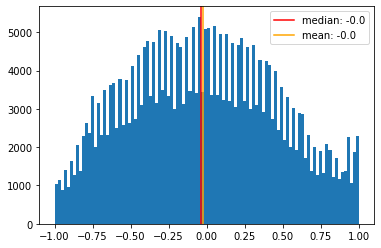

In [23]:
plt.hist(vals, bins=100)
med = np.median(vals)
mean = np.mean(vals)
plt.axvline(x=med, color="r", label=f"median: {med:.1f}")
plt.axvline(x=mean, color="orange", label=f"mean: {mean:.1f}")
plt.legend()
plt.show()

## Латентный слой

Слишком большие модели/слои не подходят под такие небольшие изображения. Потому я решил попробовать 2 различных размера латентного слоя 64/128. 

С точки зрения обоих loss функций, **меньшие модели** показали себя лучше на "чистых" данных, при этом обучение шло быстрее (как по количеству эпох, так и по времени, потраченному на одну эпоху). 

Переобучение, соответсвенно, начиналось раньше. Исправить эту проблему только аугментацией данных не вышло, хотя возможно аугментация была просто слишком сложной.

С большими моделями можео было поиграться подольше. На данных с аугментацией можно было обучить до 100 эпох без роста loss на тестовых данных. Изменяя параметры оптимизатора обучение можно было продолжить (но у меня уже не хватало ресурсов). Ну и большие модели без аугментации так же переобучались к train данным уже после 50 эпох.

## Улучшения

Из возможных улучшений процесса обучания я попробовал только несколько loss функций, размеры и различные параметры оптимизатора.

Как вариант дальнейшего улучшения - использовать архитектуру VQVAE с дискретным латентным пространством.